In [1]:
from IPython.display import display, HTML
display(HTML("<style>.container { width:100% !important; }</style>"))
from starkiller import *
import matplotlib.pyplot as plt
%matplotlib notebook

Number of sources brighter than 25: 8
Coords transformed
Calculating PSF coord shift
PSF shift:  [-2.83457917 -0.84818622  0.        ]


<IPython.core.display.Javascript object>


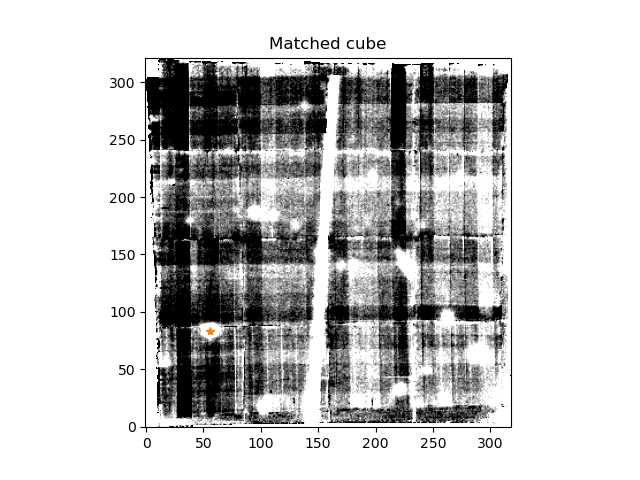

!!! Large difference of 0.28 between model_psf and data_psf!!!
Using the data_psf, override by setting psf_preference='model'
Made PSF
Using the data PSF
Background subtracted
Extracted spectra


<IPython.core.display.Javascript object>


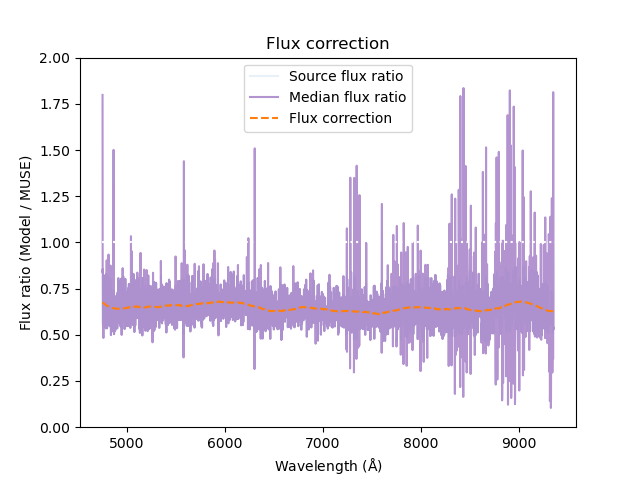

<IPython.core.display.Javascript object>


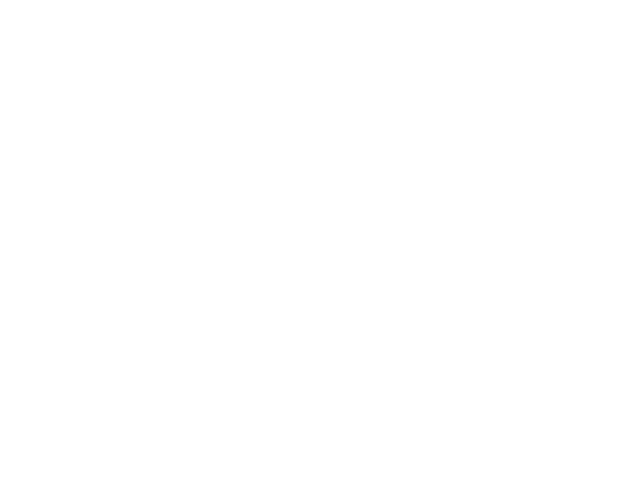

Checking for satellites


<IPython.core.display.Javascript object>


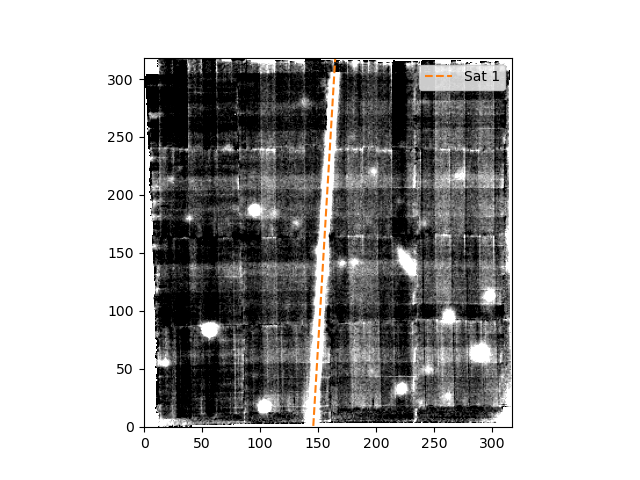

  0%|          | 0/400 [00:00<?, ?it/s]


<IPython.core.display.Javascript object>


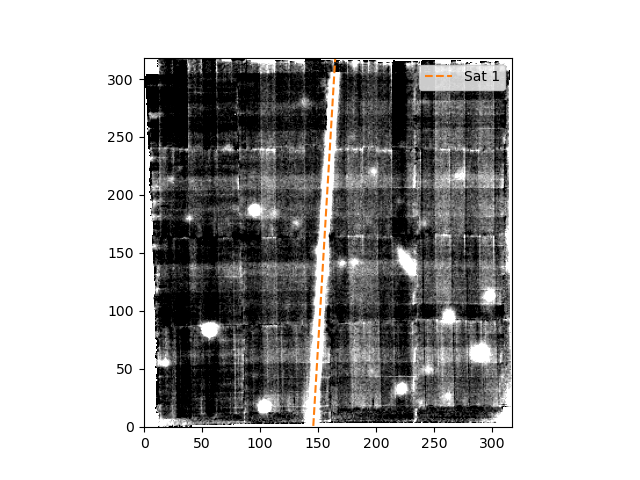

Using the data PSF
Made scene


<IPython.core.display.Javascript object>


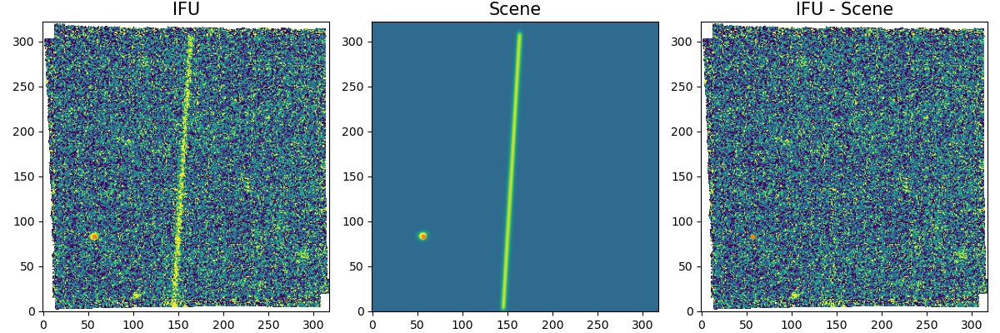

Saved reduction


In [2]:
from glob import glob
files = glob('sat/*.fits')
test = starkiller(file=files[2],run=True,numcores=7,spec_catalog='ck',
                  psf_profile='gaussian',wcs_correction=False,cal_maglim=25,
                  savepath='filename',force_flux_correction=True,satellite=True)



In [8]:
mean, median, stddev = sigma_clipped_stats(test.cube,axis=(1,2))

In [16]:
sat_psf_sum = np.nansum(test.satellite.sat_psfs[0].longpsf)

In [19]:
test.satellite.sat_fluxes[0]/stddev

array([  37.46032186,  152.75991148,  220.85810853, ..., 1800.99627585,
       1553.214713  ,  936.89172159])

In [20]:
raw = test.force_spec(x=152,y=151)
sub = test.force_spec(x=152,y=151,cube=test.diff)

In [27]:
sim = test.force_spec(x=152,y=151,cube=test.scene.sim)

In [31]:
sub_flux = sub['spec'].values[0].flux*1e20
sat_flux = sim['spec'].values[0].flux*1e20
wa = sub['spec'].values[0].flux*1e20

<IPython.core.display.Javascript object>


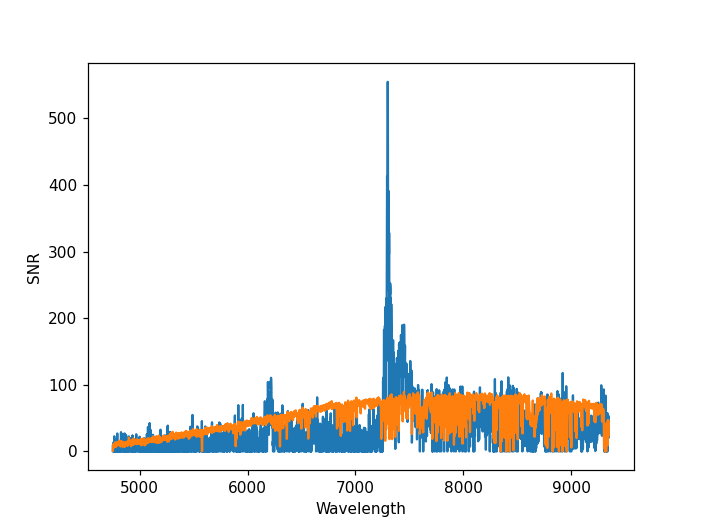

In [38]:
plt.figure()
plt.plot(test.lam,sub_flux/stddev)
plt.plot(test.lam,sat_flux/stddev)
plt.ylabel('SNR')
plt.xlabel('Wavelength')
plt.savefig('sat_blazar_snr.png')

In [39]:
test.cube.shape


(3681, 322, 318)

In [45]:
10000/(322*318) * 100

9.766006484628306

Number of sources brighter than 25: 1
Coords transformed
Calculating PSF coord shift
PSF shift:  [-0.01204256 -0.01407969  0.02581934]


<IPython.core.display.Javascript object>


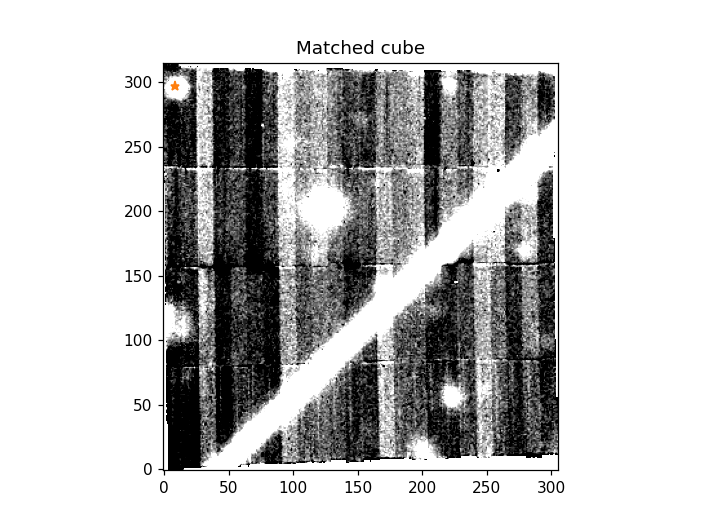

!!! Large difference of 0.47 between model_psf and data_psf!!!
Using the data_psf, override by setting psf_preference='model'
Made PSF
Using the data PSF
Background subtracted


KeyboardInterrupt: 

In [2]:
test = starkiller(file='sat/ADP.2022-07-14T15:54:47.933.fits',run=True,numcores=7,spec_catalog='ck',
                  psf_profile='gaussian',wcs_correction=False,cal_maglim=25,
                  savepath='filename',force_flux_correction=True,satellite=True)


<IPython.core.display.Javascript object>


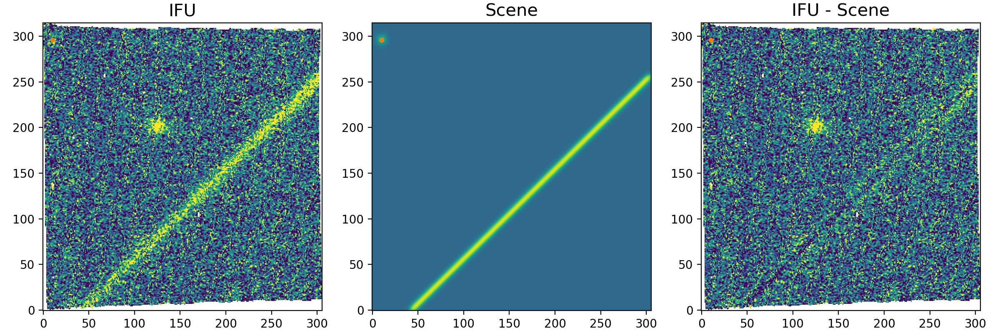

In [4]:
test.plot_diff()

<IPython.core.display.Javascript object>


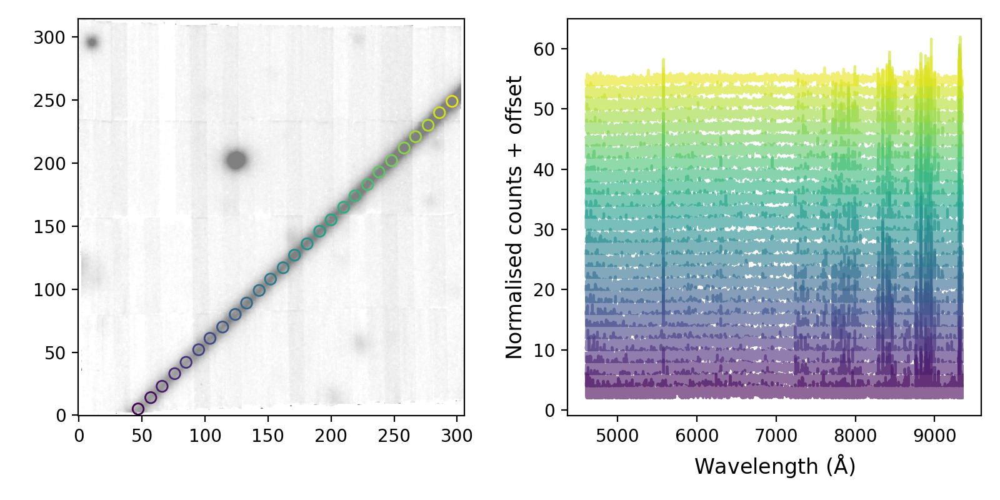

In [5]:
test.satellite.spatial_specs()

In [7]:
linecat = test.satellite.spatial_specs[0]

2 works
4 works
8 works

Number of sources brighter than 25: 5
Coords transformed
Calculating PSF coord shift
PSF shift:  [-2.83457917 -0.84818622  0.        ]


<IPython.core.display.Javascript object>


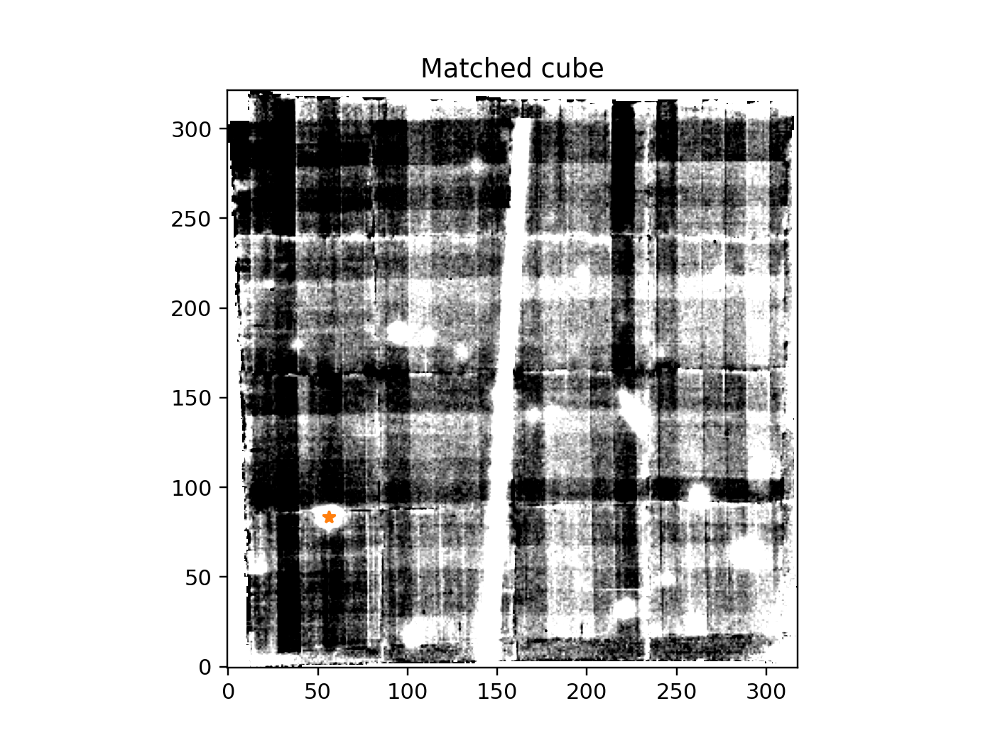

!!! Large difference of 0.28 between model_psf and data_psf!!!
Using the data_psf, override by setting psf_preference='model'
Made PSF
Using the data PSF
Background subtracted
Extracted spectra


<IPython.core.display.Javascript object>


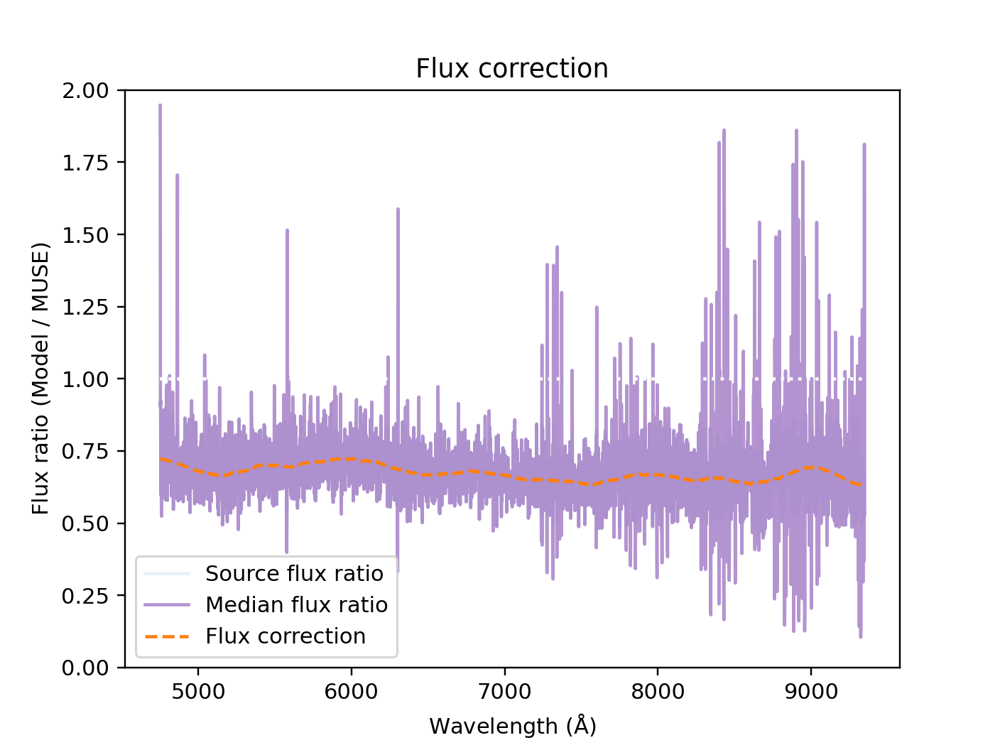

<IPython.core.display.Javascript object>


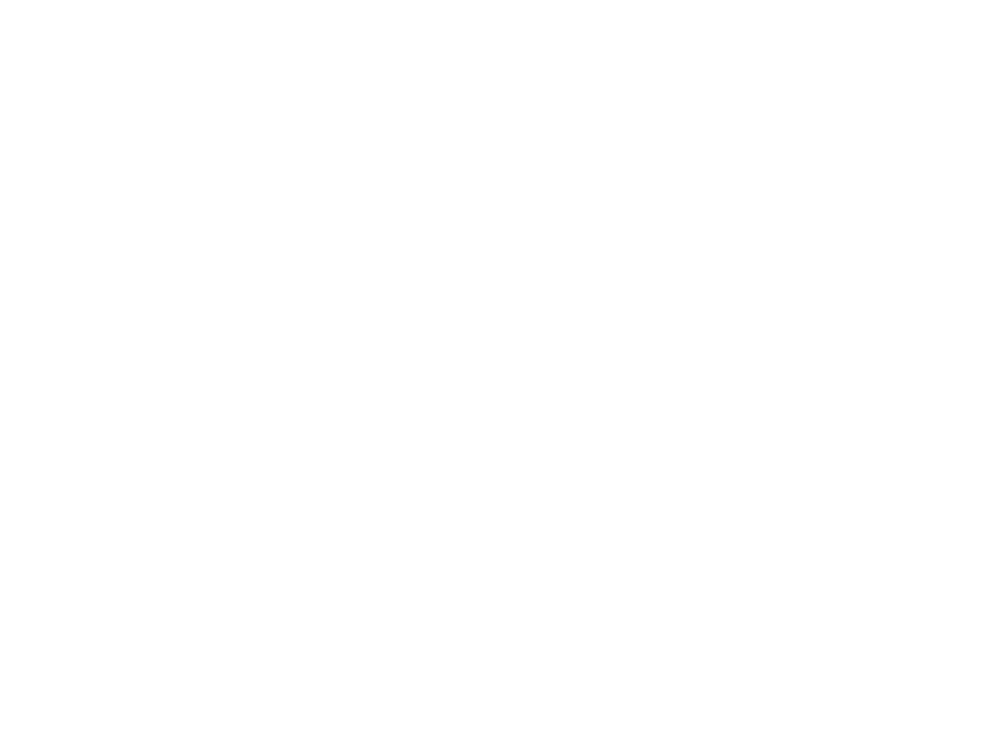

Checking for satellites


<IPython.core.display.Javascript object>


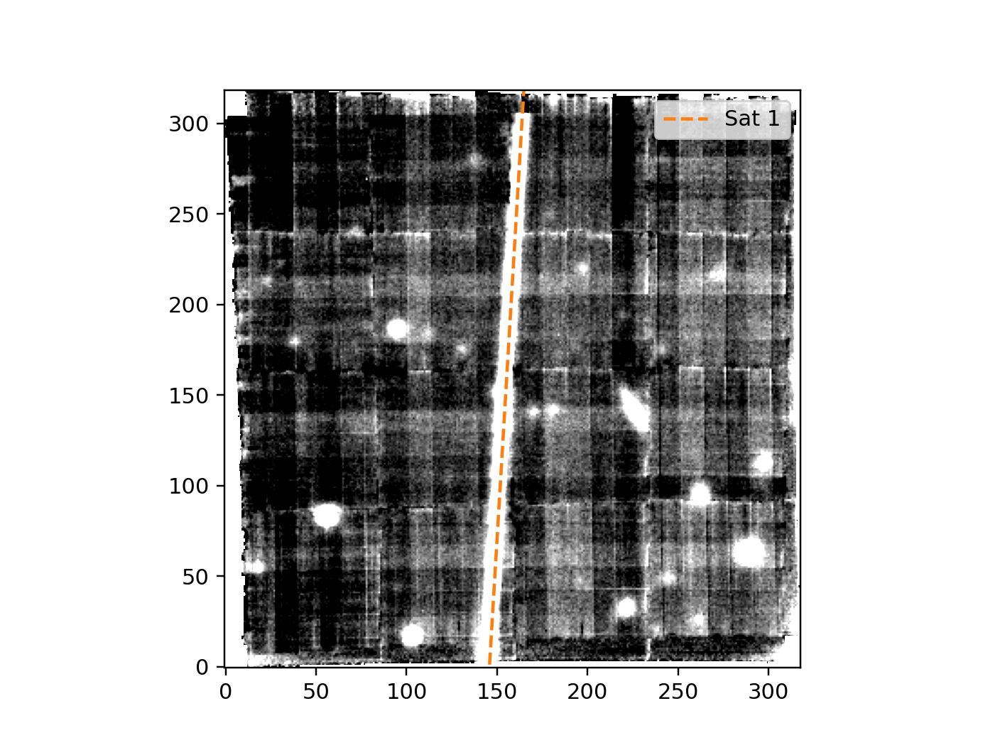

<IPython.core.display.Javascript object>


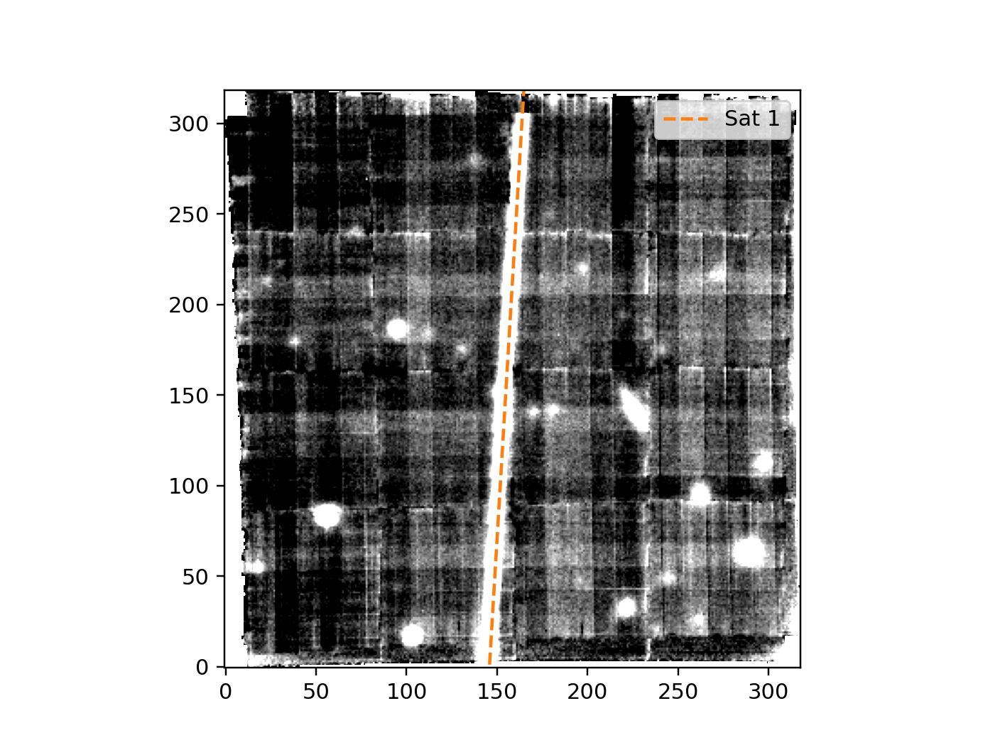

Using the data PSF
Made scene


<IPython.core.display.Javascript object>


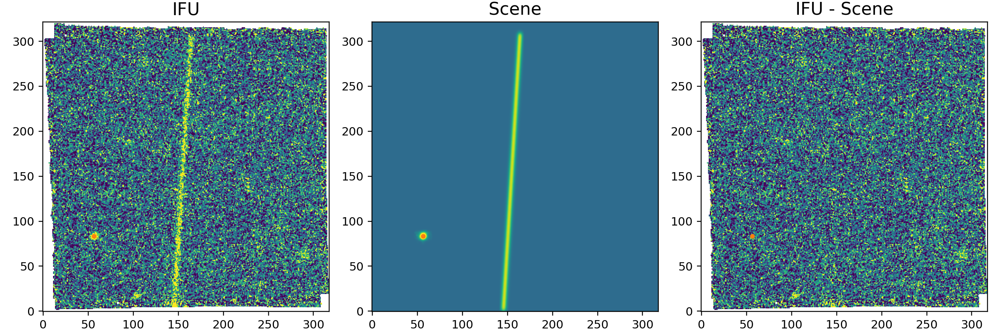

Saved reduction


<IPython.core.display.Javascript object>


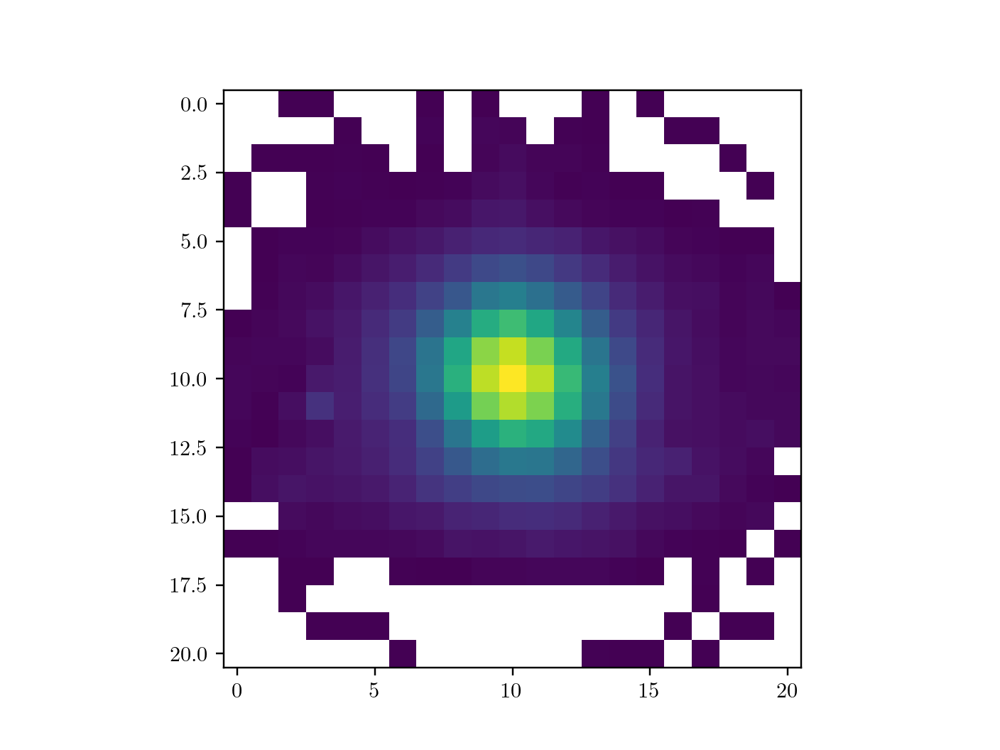

In [70]:
d = np.copy(test.psf.data_psf)
d[d==0] = np.nan
plt.figure()
plt.imshow(d)

In [73]:
test.header0

SIMPLE  =                    T / file does conform to FITS standard             
BITPIX  =                    8 / number of bits per data pixel                  
NAXIS   =                    0 / number of data axes                            
EXTEND  =                    T / FITS dataset may contain extensions            
COMMENT   FITS (Flexible Image Transport System) format is defined in 'Astronomy
COMMENT   and Astrophysics', volume 376, page 359; bibcode: 2001A&A...376..359H 
DATE    = '2022-08-10T13:09:10' / file creation date (YYYY-MM-DDThh:mm:ss UT)   
ORIGIN  = 'ESO-PARANAL'        / European Southern Observatory                  
TELESCOP= 'ESO-VLT-U4'         / ESO <TEL>                                      
INSTRUME= 'MUSE    '           / Instrument used.                               
RA      =     25.3848548314973 / [deg] Image center (J2000)                     
DEC     =    -54.4634478969861 / [deg] Image center (J2000)                     
EQUINOX =                200

In [72]:
nosat_sk.header0

SIMPLE  =                    T / file does conform to FITS standard             
BITPIX  =                    8 / number of bits per data pixel                  
NAXIS   =                    0 / number of data axes                            
EXTEND  =                    T / FITS dataset may contain extensions            
COMMENT   FITS (Flexible Image Transport System) format is defined in 'Astronomy
COMMENT   and Astrophysics', volume 376, page 359; bibcode: 2001A&A...376..359H 
DATE    = '2022-08-10T13:08:53' / file creation date (YYYY-MM-DDThh:mm:ss UT)   
ORIGIN  = 'ESO-PARANAL'        / European Southern Observatory                  
TELESCOP= 'ESO-VLT-U4'         / ESO <TEL>                                      
INSTRUME= 'MUSE    '           / Instrument used.                               
RA      =     25.3854073925008 / [deg] Image center (J2000)                     
DEC     =    -54.4634680210259 / [deg] Image center (J2000)                     
EQUINOX =                200

Number of sources brighter than 25: 5
Coords transformed
Calculating PSF coord shift
PSF shift:  [-3.05711761 -1.45209264  0.        ]


<IPython.core.display.Javascript object>


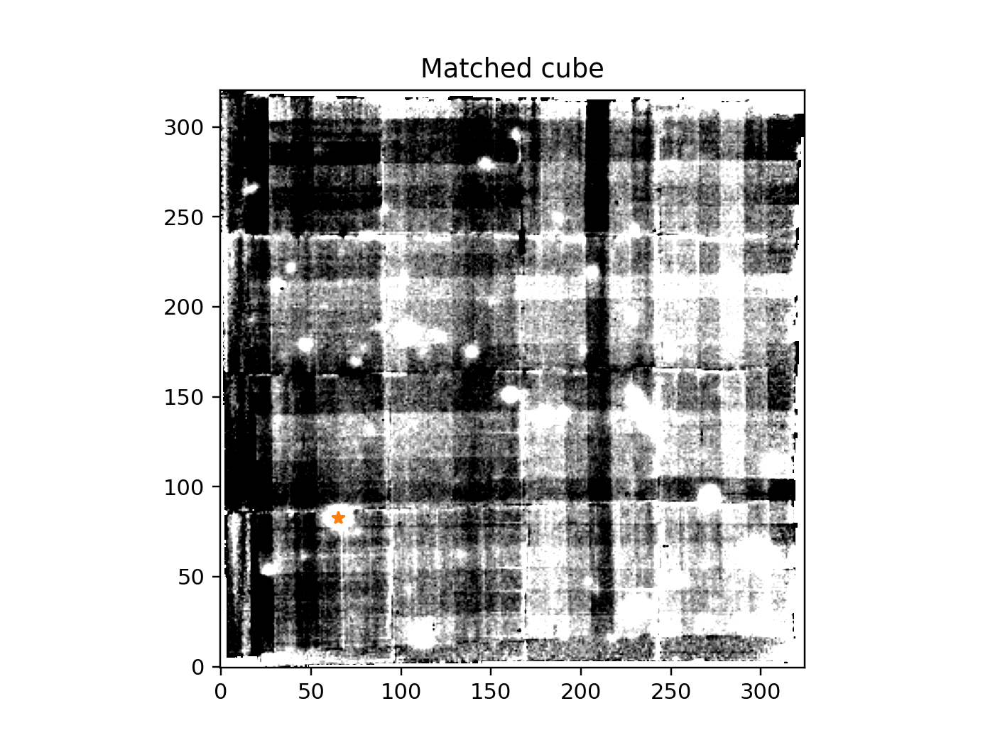

!!! Large difference of 0.21 between model_psf and data_psf!!!
Using the data_psf, override by setting psf_preference='model'
Made PSF
Using the data PSF
Background subtracted
Extracted spectra


<IPython.core.display.Javascript object>


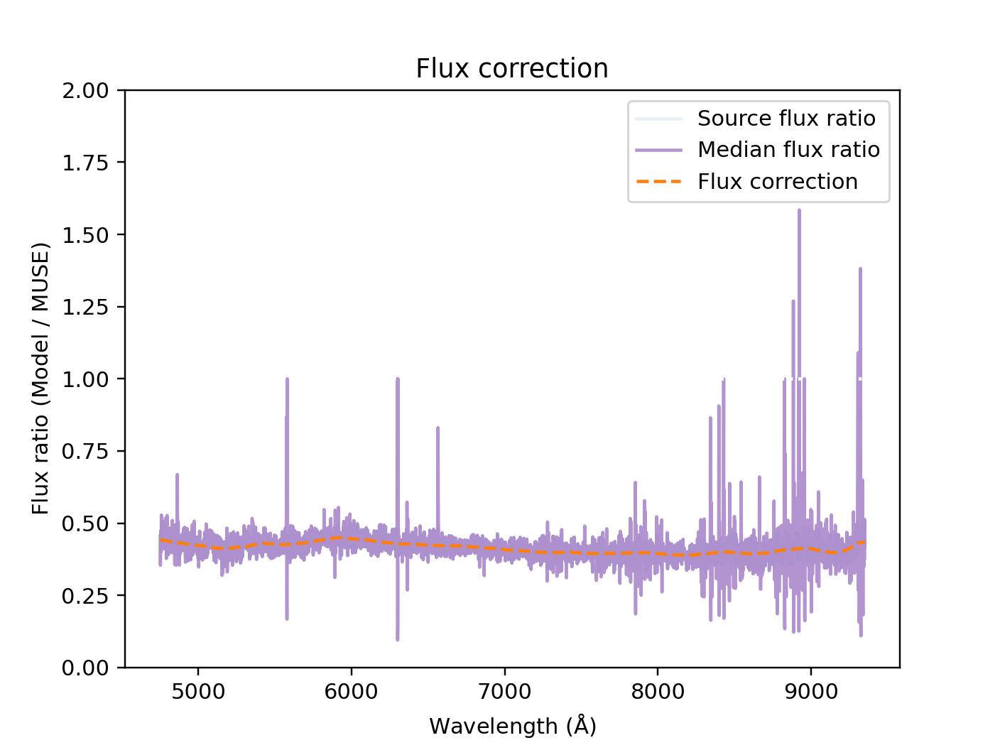

<IPython.core.display.Javascript object>


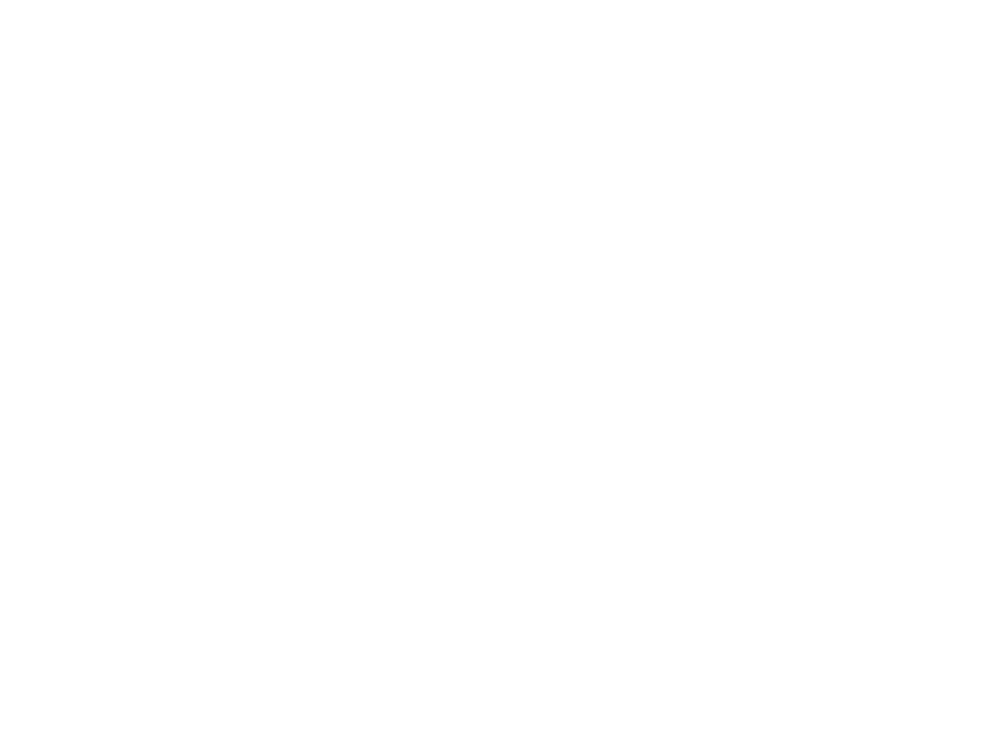

Using the data PSF
Made scene


<IPython.core.display.Javascript object>


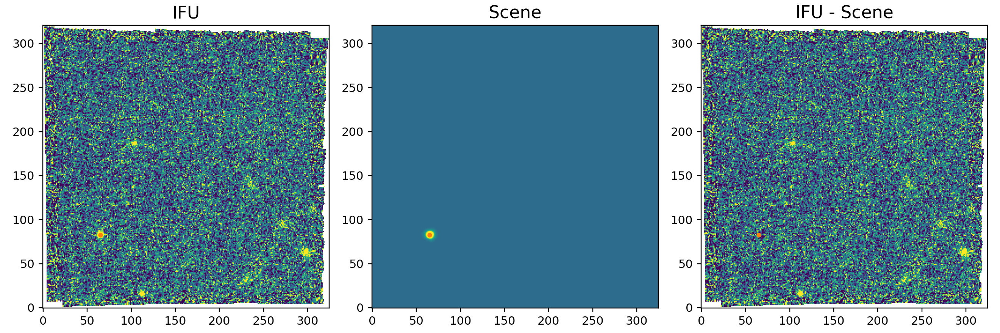

Saved reduction


In [5]:
nosat_sk = starkiller(file=files[5],run=True,numcores=7,spec_catalog='ck',
                  psf_profile='gaussian',wcs_correction=False,cal_maglim=25,
                  savepath='filename',force_flux_correction=True,satellite=False)

In [9]:
nosat.wcs.all_world2pix(25.394333,-54.467657,0,0)

[array(68.13033753), array(84.0919197), array(-3800.14726562)]

In [10]:
raw = nosat.force_spec(x=160,y=151,)

In [12]:
specs, residual, cat_off = get_specs(raw,test.cube,test.x_length,test.y_length,
                                     psf=deepcopy(test.psf),lam=test.lam,num_cores=test.numcores,
                                     fitpos=True)
cat_off['spec'] = [[]]

In [14]:
raw['spec'] = specs[0]

In [16]:
raw

,x,y,xint,yint,id,x_offset,y_offset,spec
0,158.000001,151.014573,160,151,0,-1.999999,0.014573,0


In [17]:
for i in range(len(specs)):
    cat_off['spec'].iloc[i] = specs[i]

In [18]:
cat_off['spec2'] = specs[i]

In [9]:
#cat_off.spec.iloc[0].wave
import numpy as np

In [10]:
raw = test.force_spec(x=152,y=151)
sub = test.force_spec(x=152,y=151,cube=test.diff)
sim = test.force_spec(x=152,y=151,cube=test.scene.sim)
nosat = nosat_sk.force_spec(x=160,y=151)

In [11]:
diff = np.nanmedian(test.diff,axis=0)

In [12]:
plt.rc('text', usetex=True)
plt.rc('font', family='serif')

fig_width_pt = 240.0  # Get this from LaTeX using \showthe\columnwidth
inches_per_pt = 1.0/72.27               # Convert pt to inches
golden_mean = (np.sqrt(5)-1.0)/2.0         # Aesthetic ratio
fig_width = fig_width_pt*inches_per_pt  # width in inches

In [19]:
model = at.Table.read('sat/solar_spectrum.dat', format='ascii')
sun = S.ArraySpectrum(wave=model['col1'].value[:-1]*10,
                            flux=model['col2'].value[:-1].astype(float),fluxunits='flam',name='sun')
sol = sun.resample(sub.spec.iloc[0].wave)



In [23]:
from pyExtinction import ExtinctionModel

def atmo_minimiser(pars,model,spec,atmo):
    dpars = [0,0,0,0]
    aext = atmo.extinction(components=True,pars=pars,dpars=dpars)
    ext = S.ArraySpectrum(model.wave, apply(aext[0],model.flux))
    interp = ext.sample(spec.wave)
    corr = pearsonr(savgol_filter(spec.flux,101,1),interp)[0]
    res = -corr

    return res

def fit_atmo_ext(model,spec):
    pars = [616,257,7.6e-3,1.26]
    dpars = [0,0,0,0]
    bds = [[0,1e4],[257,1e4],[0,1],[0,3]]
    atmo = ExtinctionModel(lbda=model.wave)
    res = minimize(atmo_minimiser, pars,args=(model,spec,atmo),bounds=bds,method='Powell')
    r = res.x
    aext = atmo.extinction(components=True,pars=r,dpars=dpars)
    ext = S.ArraySpectrum(model.wave, apply(aext[0],model.flux))
    return ext,atmo

sat = S.ArraySpectrum(wave=sub.spec.iloc[0].wave,flux=sim.spec.iloc[0].flux*1e16)
sol_atmo, aext = fit_atmo_ext(sol,sat)

<IPython.core.display.Javascript object>


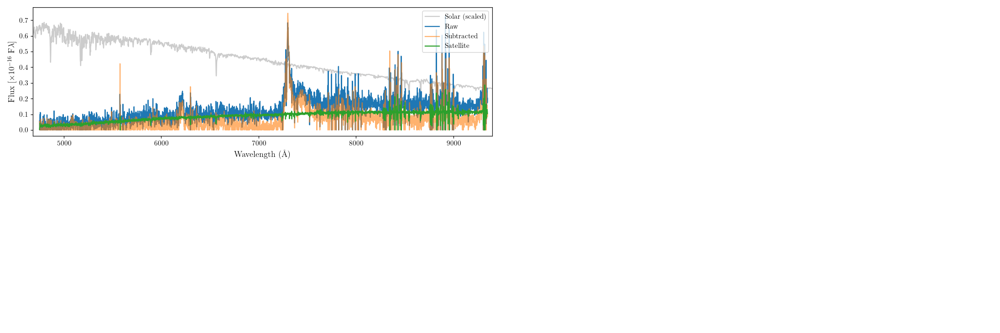

In [10]:
plt.figure(figsize=(1.5*2*fig_width,1*fig_width))

plt.plot(sun.wave,sun.flux/np.nanmax(sun.flux)*0.7,'-',color='gray',alpha=0.4,label='Solar (scaled)')
plt.plot(raw.spec.iloc[0].wave,raw.spec.iloc[0].flux*1e16,label='Raw')
plt.plot(sub.spec.iloc[0].wave,sub.spec.iloc[0].flux*1e16,alpha=.6,label='Subtracted')
plt.plot(sub.spec.iloc[0].wave,sim.spec.iloc[0].flux*1e16,alpha=1,label='Satellite')

#plt.plot(nosat.spec.iloc[0].wave,nosat.spec.iloc[0].flux*1e16,alpha=1,label='No sat')

plt.xlim(4680,9400)

plt.ylabel(r'Flux $\left[\rm \times10^{-16}\; F\lambda\right]$',fontsize=12)
plt.xlabel(r'Wavelength ($\rm \AA$)',fontsize=12)
#plt.legend(bbox_to_anchor=(0, 1.02, 1, 0.2), loc="lower left",
#            mode="expand", borderaxespad=0, ncol=4)
plt.legend()
plt.tight_layout()
plt.savefig('Satellite_spec_subtraction_big.pdf',bbox_inches='tight')

<IPython.core.display.Javascript object>


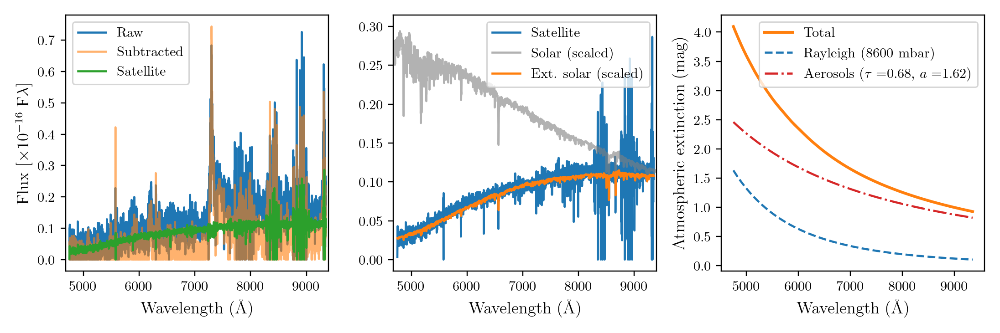

In [135]:
plt.figure(figsize=(1.5*2*fig_width,1*fig_width))
plt.subplot(131)
plt.plot(raw.spec.iloc[0].wave,raw.spec.iloc[0].flux*1e16,label='Raw')
plt.plot(sub.spec.iloc[0].wave,sub.spec.iloc[0].flux*1e16,alpha=.6,label='Subtracted')
plt.plot(sub.spec.iloc[0].wave,sim.spec.iloc[0].flux*1e16,alpha=1,label='Satellite')
plt.xlim(4680,9400)
plt.ylabel(r'Flux $\left[\rm \times10^{-16}\; F\lambda\right]$',fontsize=12)
plt.xlabel(r'Wavelength ($\rm \AA$)',fontsize=12)

plt.legend()

plt.subplot(132)
plt.plot(sub.spec.iloc[0].wave,sim.spec.iloc[0].flux*1e16,alpha=1,label='Satellite')
plt.plot(sun.wave,sun.flux/np.nanmax(sun.flux)*0.3,'-',color='gray',alpha=0.6,label='Solar (scaled)')

plt.plot(sol_atmo.wave,sol_atmo.flux/np.nanmax(sol_atmo.flux)*0.1+0.015,'-',label='Ext. solar (scaled)')
plt.xlabel(r'Wavelength ($\rm \AA$)',fontsize=12)

#plt.plot(nosat.spec.iloc[0].wave,nosat.spec.iloc[0].flux*1e16,alpha=1,label='No sat')

plt.xlim(4680,9400)





#plt.legend(bbox_to_anchor=(0, 1.02, 1, 0.2), loc="lower left",
#            mode="expand", borderaxespad=0, ncol=4)
plt.legend()

plt.subplot(133)
ext = aext.extinction(components=True)

p, o3, tau, ang = aext.p

# Total extinction and errorband
plt.plot(aext.lbda, ext[0], color='C1', lw=2, label='Total')
plt.fill_between(aext.lbda, ext[0] - ext[1], ext[0] + ext[1], alpha=0.3,color=green)

#if components:                      # Physical components
plt.plot(aext.lbda, ext[2], color='C0', ls='--',
        label=f'Rayleigh ({int(p)} mbar)')
#plt.plot(aext.lbda, ext[3], color=blue, ls=':',
#        label=f'Ozone [{int(o3)} DU]')
plt.plot(aext.lbda, ext[4], color='C3', ls='-.',
        label=r'Aerosols ($\tau=$'+str(np.round(tau,2)) + r', $a=$'+str(np.round(ang,2)) + ')')

#plt.yscale('log')
plt.legend(loc='best')
plt.ylabel('Atmospheric extinction (mag)',fontsize=12)
plt.xlabel(r'Wavelength $(\rm \AA)$',fontsize=12)



plt.tight_layout()
plt.savefig('Satellite_spec_subtraction_three.pdf',bbox_inches='tight')

<IPython.core.display.Javascript object>


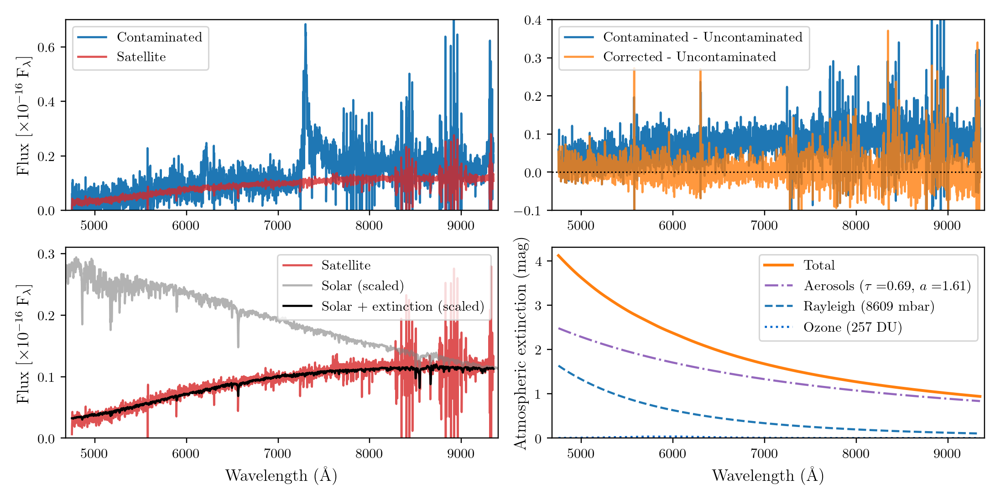

In [34]:
blue, red, green, orange = ('#0066CC', '#CC0033', '#009966', '#FF9900')
plt.figure(figsize=(1.5*2*fig_width,1*fig_width * 1.5))
plt.subplot(221)
plt.plot(raw.spec.iloc[0].wave,raw.spec.iloc[0].flux*1e16,c='C0',label='Contaminated')
#plt.plot(sub.spec.iloc[0].wave,sub.spec.iloc[0].flux*1e16,alpha=.6,label='Subtracted')
plt.plot(sub.spec.iloc[0].wave,sim.spec.iloc[0].flux*1e16,color='C3',label='Satellite',alpha=0.8)
plt.xlim(4680,9400)
plt.ylim(0,0.7)
plt.ylabel(r'Flux $\left[\rm \times10^{-16}\; F_\lambda\right]$',fontsize=12)
#plt.xlabel(r'Wavelength ($\rm \AA$)',fontsize=12)

plt.legend()

plt.subplot(222)
#plt.plot(nosat.spec.iloc[0].wave,nosat.spec.iloc[0].flux*1e16+0.5,label='Uncontaminated + offset')
#plt.plot(sub.spec.iloc[0].wave,sub.spec.iloc[0].flux*1e16,label='Subtracted')
#plt.axhline(0.5,ls=':',c='k',lw=1)
plt.plot(nosat.spec.iloc[0].wave,(raw.spec.iloc[0].flux - (nosat.spec.iloc[0].flux*.6))*1e16,label='Contaminated - Uncontaminated')
plt.plot(nosat.spec.iloc[0].wave,(sub.spec.iloc[0].flux - (nosat.spec.iloc[0].flux*.6))*1e16,alpha=0.8,label='Corrected - Uncontaminated')
plt.axhline(0,ls=':',c='k',lw=1)
plt.legend()
plt.xlim(4680,9400)
#plt.ylim(0,1.7)
plt.ylim(-0.1,0.4)

plt.subplot(223)
plt.plot(sub.spec.iloc[0].wave,sim.spec.iloc[0].flux*1e16,color='C3',label='Satellite',alpha=0.8)
plt.plot(sun.wave,sun.flux/np.nanmax(sun.flux)*0.3,'-',color='gray',alpha=0.6,label='Solar (scaled)')

plt.plot(sol_atmo.wave,sol_atmo.flux/np.nanmax(sol_atmo.flux)*0.1+0.02,'k-',label='Solar + extinction (scaled)')
plt.xlabel(r'Wavelength ($\rm \AA$)',fontsize=12)
plt.ylabel(r'Flux $\left[\rm \times10^{-16}\; F_\lambda\right]$',fontsize=12)
#plt.plot(nosat.spec.iloc[0].wave,nosat.spec.iloc[0].flux*1e16,alpha=1,label='No sat')

plt.xlim(4680,9400)
plt.ylim(0,0.31)




#plt.legend(bbox_to_anchor=(0, 1.02, 1, 0.2), loc="lower left",
#            mode="expand", borderaxespad=0, ncol=4)
plt.legend()

plt.subplot(224)
ext = aext.extinction(components=True)

p, o3, tau, ang = aext.p

# Total extinction and errorband
plt.plot(aext.lbda, ext[0], color='C1', lw=2, label='Total')
plt.fill_between(aext.lbda, ext[0] - ext[1], ext[0] + ext[1], alpha=0.3,color=green)

#if components:                      # Physical components
plt.plot(aext.lbda, ext[4], color='C4', ls='-.',
        label=r'Aerosols ($\tau=$'+str(np.round(tau,2)) + r', $a=$'+str(np.round(ang,2)) + ')')
plt.plot(aext.lbda, ext[2], color='C0', ls='--',
        label=f'Rayleigh ({int(p)} mbar)')

plt.plot(aext.lbda, ext[3], color=blue, ls=':',
        label=f'Ozone ({int(o3)} DU)')

#plt.yscale('log')
plt.legend(loc='best')
plt.ylabel('Atmospheric extinction (mag)',fontsize=12)
plt.xlabel(r'Wavelength $(\rm \AA)$',fontsize=12)
plt.xlim(4680,9400)
plt.ylim(0,4.3)


plt.tight_layout()
plt.savefig('Satellite_spec_subtraction_four.pdf',bbox_inches='tight')

In [225]:
test.psf_param[0] - nosat_sk.psf_param[0]

0.2771048425718212

In [224]:
nosat_sk.psf_param

array([1.93783609, 1.09446309, 0.        ])

In [ ]:
2960 s

In [197]:
test.hdu[0].header['EXPTIME']

2737.08003698757

In [198]:
nosat_sk.hdu[0].header['EXPTIME']

2657.25058351786

<IPython.core.display.Javascript object>


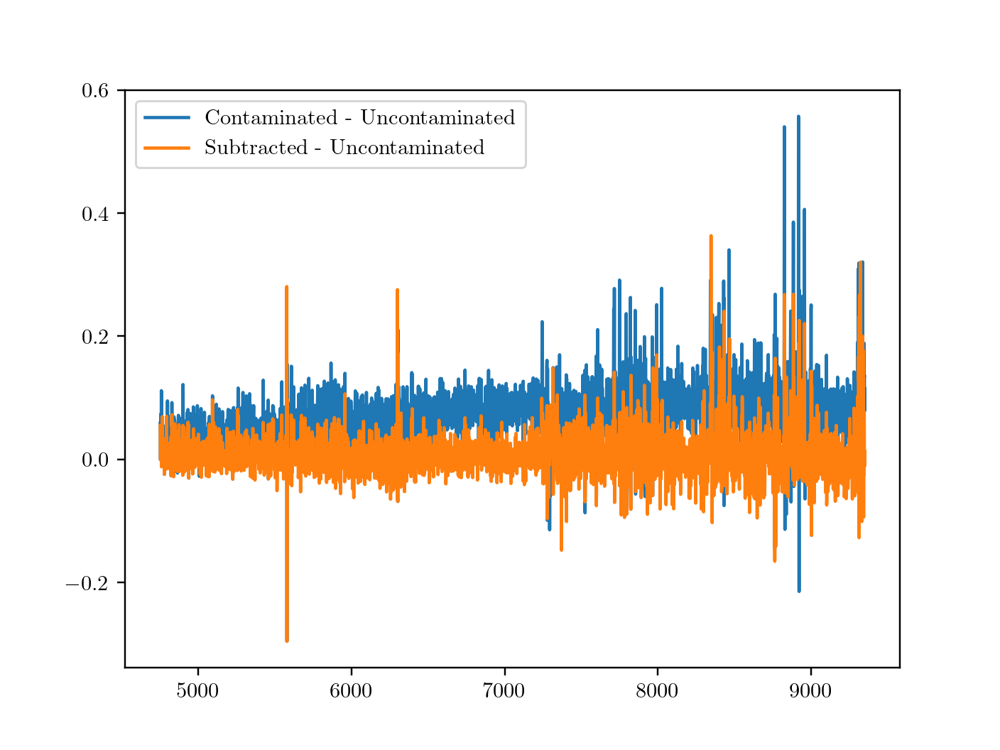

In [212]:
plt.figure()
#plt.plot(nosat.spec.iloc[0].wave,(nosat.spec.iloc[0].flux)*1e16,label='Uncontaminated + offset')
plt.plot(nosat.spec.iloc[0].wave,(raw.spec.iloc[0].flux - nosat.spec.iloc[0].flux*.6 )*1e16,label='Contaminated - Uncontaminated')
plt.plot(nosat.spec.iloc[0].wave,(sub.spec.iloc[0].flux - nosat.spec.iloc[0].flux*.6)*1e16,label='Subtracted - Uncontaminated')
plt.legend()


In [12]:
from pyExtinction import ExtinctionModel

In [14]:
pars = [616,257,7.6e-3,1.26]
dpars = [0,0,0,0]
aext = atmo.extinction(components=True,pars=pars,dpars=dpars)

NameError: name 'atmo' is not defined

In [115]:
aext.shape

(5, 3681)

<IPython.core.display.Javascript object>


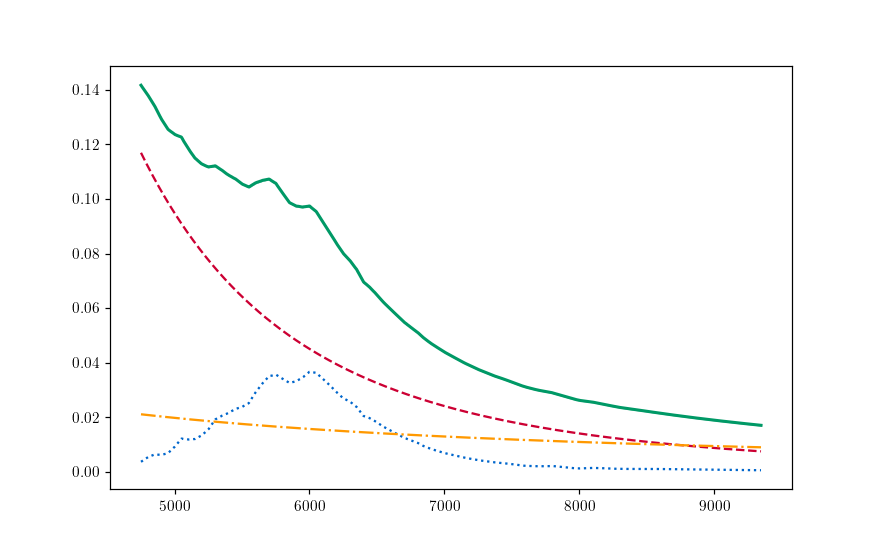

In [118]:
components=True; transmission=False; ax = None
ext = atmo.extinction(components=True)

p, o3, tau, ang = atmo.p

# Non-default colors
blue, red, green, orange = ('#0066CC', '#CC0033', '#009966', '#FF9900')


fig = plt.figure(figsize=(8, 5))

# Total extinction and errorband
plt.plot(atmo.lbda, ext[0], color=green, lw=2, label='Total')
plt.fill_between(atmo.lbda, ext[0] - ext[1], ext[0] + ext[1], alpha=0.3,color=green)

if components:                      # Physical components
    plt.plot(atmo.lbda, ext[2], color=red, ls='--',
            label='Rayleigh [%.0f mbar]' % p)
    plt.plot(atmo.lbda, ext[3], color=blue, ls=':',
            label='Ozone [%.0f DU]' % o3)
    plt.plot(atmo.lbda, ext[4], color=orange, ls='-.',
            label=u'Aerosols [τ=%.4f, å=%.2f]' % (tau, ang))

plt.legend(loc='best')

In [ ]:
plt.

In [120]:
eh = apply(ext[0],sol.flux)

<IPython.core.display.Javascript object>


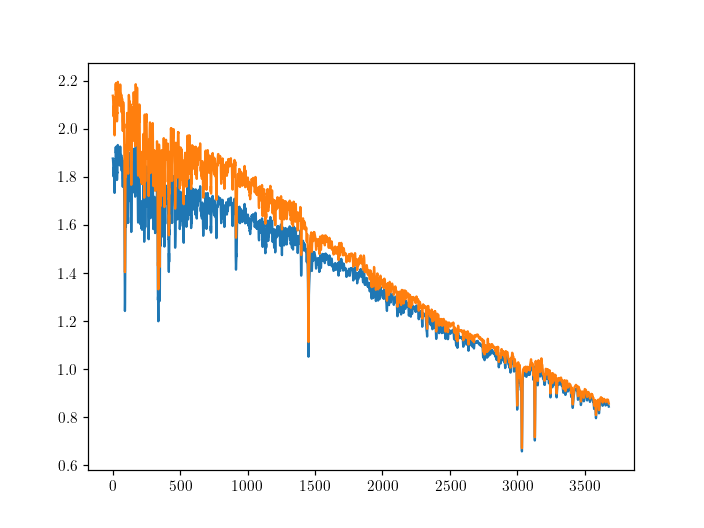

In [122]:
plt.figure()
plt.plot(eh)
plt.plot(sol.flux)

In [21]:
from pyExtinction import ExtinctionModel

def atmo_minimiser(pars,model,spec,atmo):
    dpars = [0,0,0,0]
    aext = atmo.extinction(components=True,pars=pars,dpars=dpars)
    ext = S.ArraySpectrum(model.wave, apply(aext[0],model.flux))
    interp = ext.sample(spec.wave)
    corr = pearsonr(savgol_filter(spec.flux,101,1),interp)[0]
    res = -corr

    return res

def fit_atmo_ext(model,spec):
    pars = [616,257,7.6e-3,1.26]
    dpars = [0,0,0,0]
    bds = [[0,1e4],[257,1e4],[0,1],[0,3]]
    atmo = ExtinctionModel(lbda=model.wave)
    res = minimize(atmo_minimiser, pars,args=(model,spec,atmo),bounds=bds,method='Powell')
    r = res.x
    aext = atmo.extinction(components=True,pars=r,dpars=dpars)
    ext = S.ArraySpectrum(model.wave, apply(aext[0],model.flux))
    return ext,atmo
sat = S.ArraySpectrum(wave=sub.spec.iloc[0].wave,flux=sim.spec.iloc[0].flux*1e16)
sol_atmo, aext = fit_atmo_ext(sol,sat)

In [22]:
sat = S.ArraySpectrum(wave=sub.spec.iloc[0].wave,flux=sim.spec.iloc[0].flux*1e16)
sol_atmo, aext = fit_atmo_ext(sol,sat)

<IPython.core.display.Javascript object>


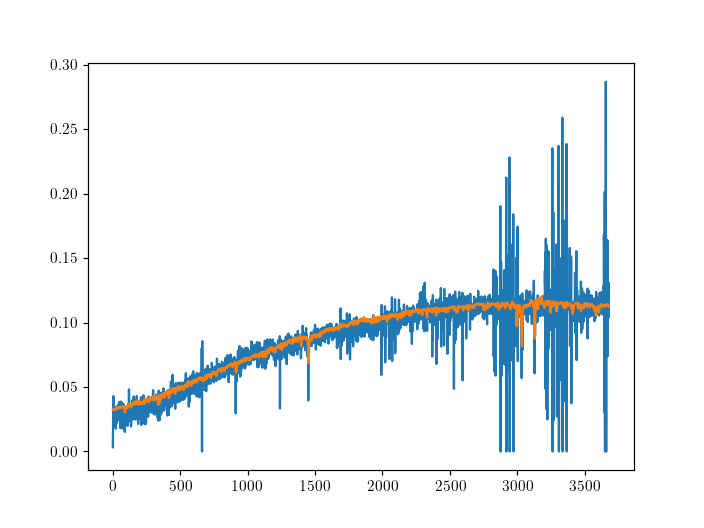

In [73]:
plt.figure()
plt.plot(sat.flux)
plt.plot(sol_atmo.flux/np.nanmax(sol_atmo.flux)*.1+.02)

In [81]:
ang

1.618438343208387

<IPython.core.display.Javascript object>


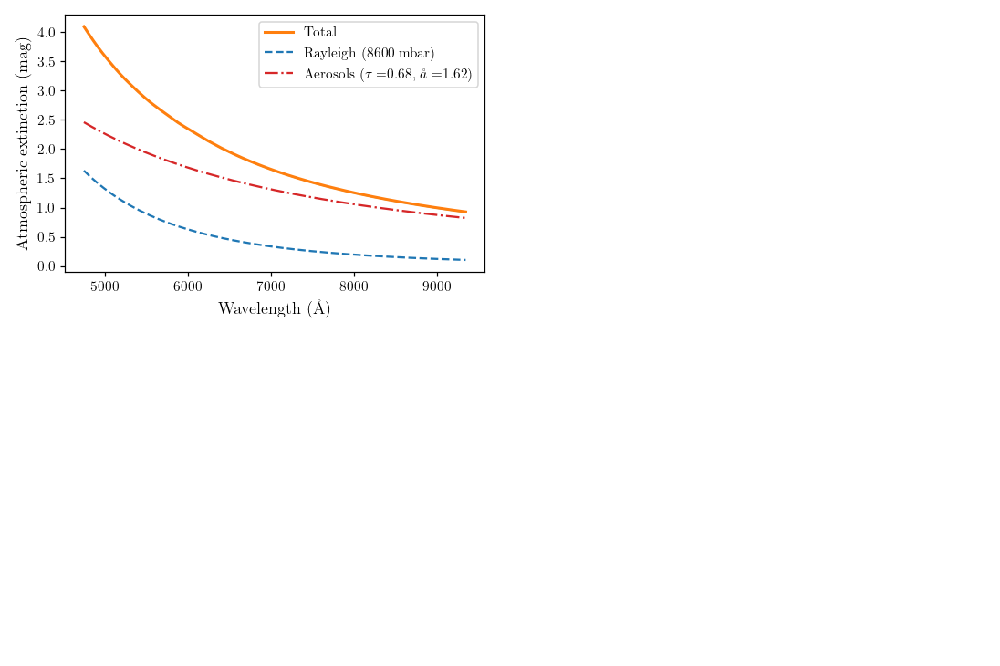

In [130]:
ext = aext.extinction(components=True)

p, o3, tau, ang = aext.p

# Non-default colors
blue, red, green, orange = ('#0066CC', '#CC0033', '#009966', '#FF9900')


plt.figure(figsize=(1.5*fig_width,1*fig_width))

# Total extinction and errorband
plt.plot(aext.lbda, ext[0], color='C1', lw=2, label='Total')
plt.fill_between(aext.lbda, ext[0] - ext[1], ext[0] + ext[1], alpha=0.3,color=green)

#if components:                      # Physical components
plt.plot(aext.lbda, ext[2], color='C0', ls='--',
        label=f'Rayleigh ({int(p)} mbar)')
#plt.plot(aext.lbda, ext[3], color=blue, ls=':',
#        label=f'Ozone [{int(o3)} DU]')
plt.plot(aext.lbda, ext[4], color='C3', ls='-.',
        label=r'Aerosols ($\tau=$'+str(np.round(tau,2)) + r', $\mathring{a}=$'+str(np.round(ang,2)) + ')')

#plt.yscale('log')
plt.legend(loc='best')
plt.ylabel('Atmospheric extinction (mag)',fontsize=12)
plt.xlabel(r'Wavelength $(\rm \AA)$',fontsize=12)
#plt.legend(bbox_to_anchor=(0, 1.02, 1, 0.2), loc="lower left",
#            mode="expand", borderaxespad=0, ncol=2)
plt.tight_layout()
plt.savefig('atmo_extinction_fit.png')

In [26]:
from pyExtinction import *

In [27]:
O3Template

'/Users/rri38/miniconda3/lib/python3.9/site-packages/pyExtinction/data/ozoneTemplate.fits'

In [132]:
pars is not None

True

In [129]:
None not in (pars, 0)

False

<IPython.core.display.Javascript object>


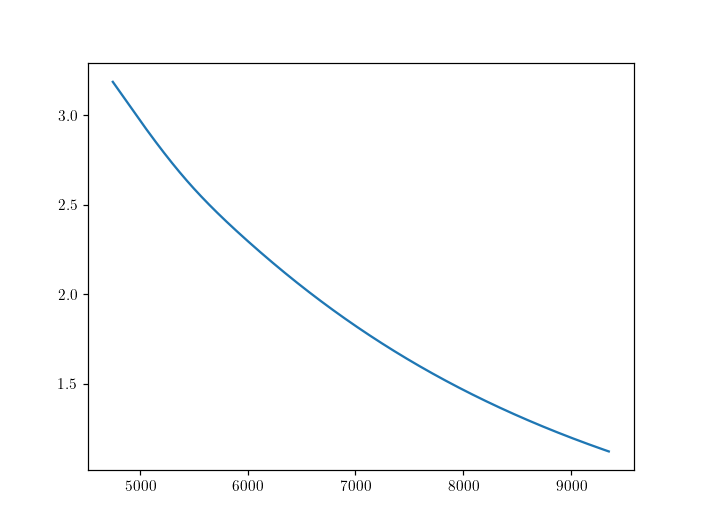

In [111]:
plt.figure()
plt.plot(sol.wave,fitzpatrick99(sol.wave.astype('double'),ebv*3.1,3.1))

In [60]:
sol_ext, ebv = fit_extinction(sol,sat)

In [45]:
(6562.7- 6562) / 6562 * 299792

31.98024992379541

In [36]:
((5873 - 5890) / 5873)* 3e6

-8683.807253533118

<IPython.core.display.Javascript object>


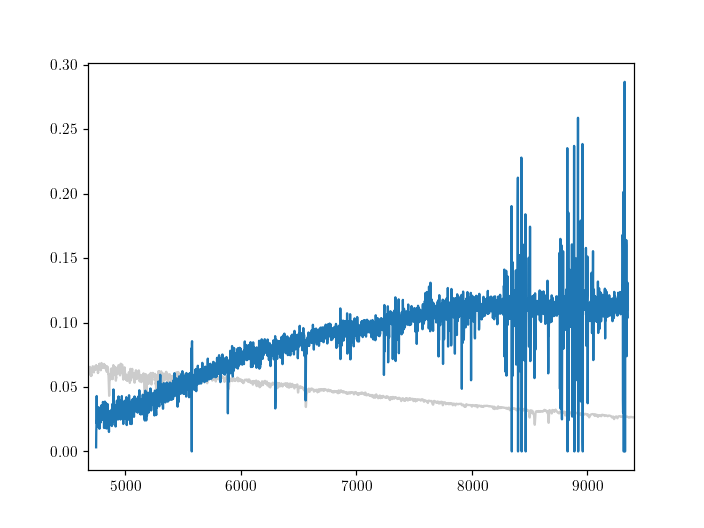

(4680.0, 9400.0)

In [39]:
plt.figure()
plt.plot(sun.wave*10,sun.flux/np.nanmax(sun.flux)*0.07,'-',color='gray',alpha=0.4,label='Solar (scaled)')
plt.plot(sub.spec.iloc[0].wave,sim.spec.iloc[0].flux*1e16,alpha=1,label='Satellite')
plt.xlim(4680,9400)

<IPython.core.display.Javascript object>


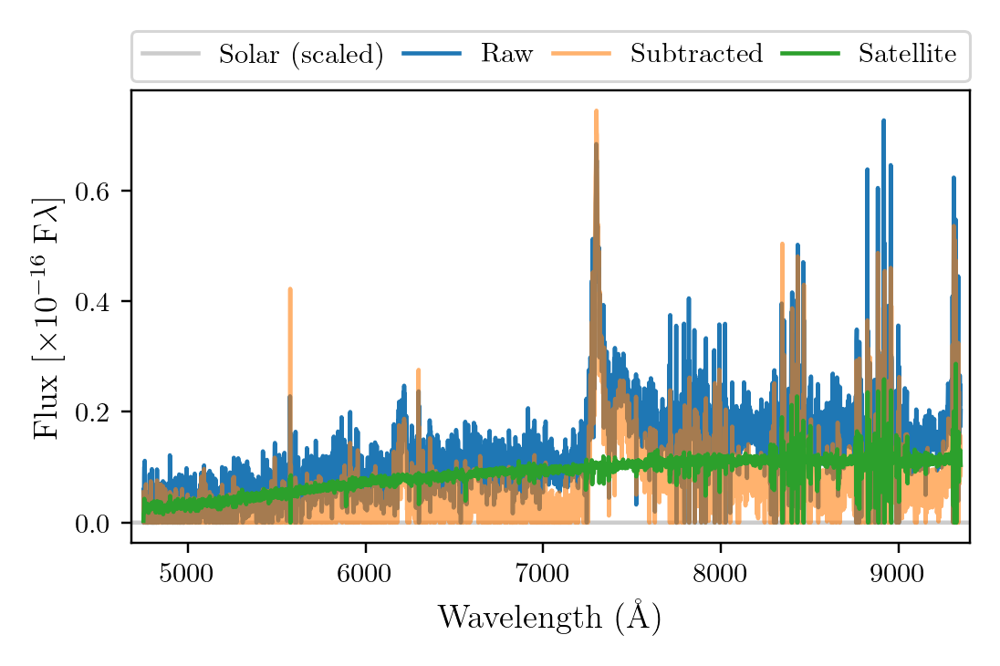

In [131]:
plt.figure(figsize=(1.5*fig_width,1*fig_width))

plt.plot(sun.wave*10,sun.flux/np.nanmax(sun.flux)*0.7,'-',color='gray',alpha=0.4,label='Solar (scaled)')
plt.plot(raw.spec.iloc[0].wave,raw.spec.iloc[0].flux*1e16,label='Raw')
plt.plot(sub.spec.iloc[0].wave,sub.spec.iloc[0].flux*1e16,alpha=.6,label='Subtracted')
plt.plot(sub.spec.iloc[0].wave,sim.spec.iloc[0].flux*1e16,alpha=1,label='Satellite')

#plt.plot(nosat.spec.iloc[0].wave,nosat.spec.iloc[0].flux*1e16,alpha=1,label='No sat')


plt.xlim(4680,9400)

plt.ylabel(r'Flux $\left[\rm \times10^{-16}\; F\lambda\right]$',fontsize=12)
plt.xlabel(r'Wavelength ($\rm \AA$)',fontsize=12)
plt.legend(bbox_to_anchor=(0, 1.02, 1, 0.2), loc="lower left",
            mode="expand", borderaxespad=0, ncol=4)
plt.tight_layout()
#plt.savefig('Satellite_spec_subtraction.pdf',bbox_inches='tight')

In [58]:
from astropy.io import ascii

In [59]:
telluric = ascii.read('../starkiller/data/telluric_lines.dat')

In [65]:
tel = telluric['lam_c'].value
tel = tel[(tel < 9500)]

<IPython.core.display.Javascript object>


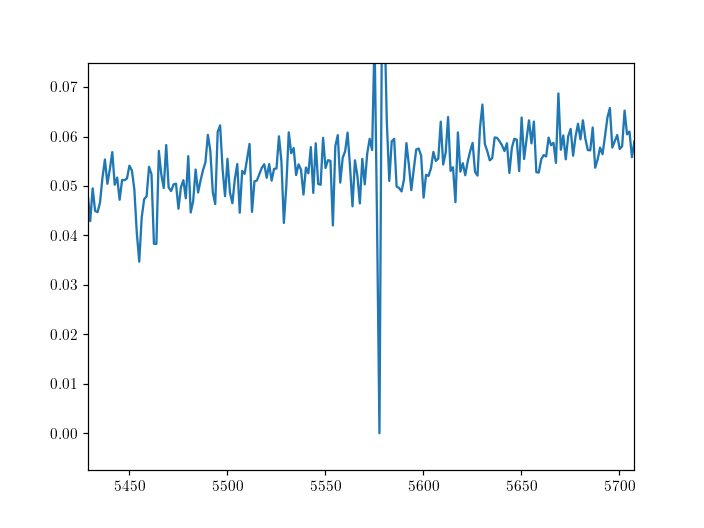

In [66]:
plt.figure()
plt.plot(sim.spec.iloc[0].wave,(sim.spec.iloc[0].flux)*1e16)
for t in tel:
    plt.axvline(t,color='C1')

In [7]:
thing = np.nanmedian(test.diff,axis=0)

<IPython.core.display.Javascript object>


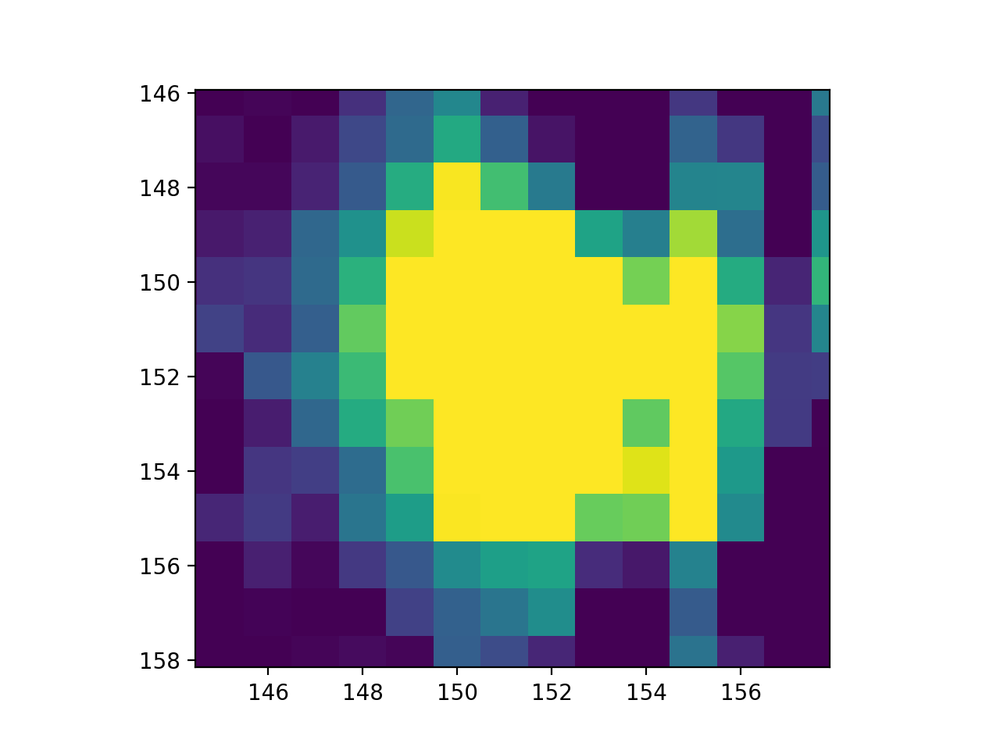

In [8]:
plt.figure()
plt.imshow(thing,vmin=0,vmax=5)

<IPython.core.display.Javascript object>


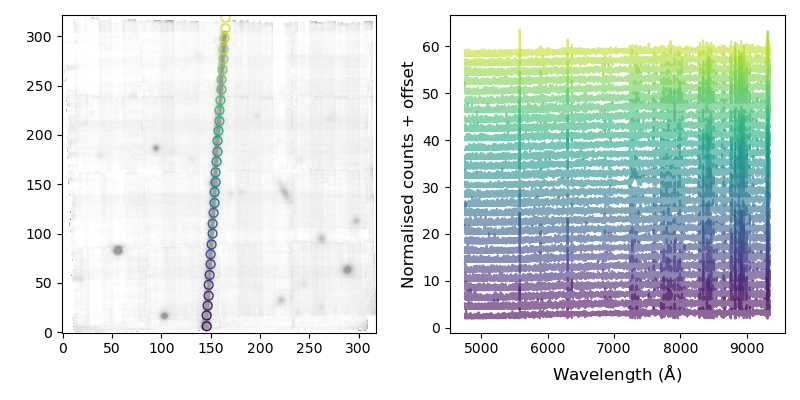

In [6]:
test.satellite.spatial_specs()

In [19]:
colours = cm.viridis(cm.rainbow(np.linspace(0, 1, len(linecat))))

In [22]:
linecat['xint'].values.shape

(31,)

<IPython.core.display.Javascript object>


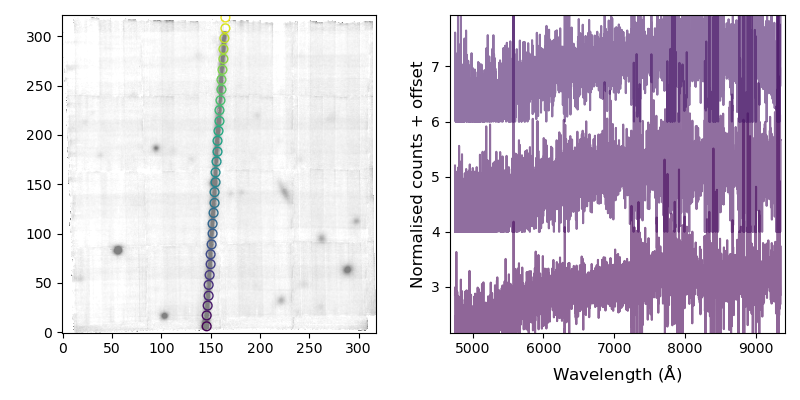

In [7]:
for linecat in test.satellite.spatial_specs:
    cmap = plt.get_cmap('viridis')
    norm = plt.Normalize(0, len(linecat))
    colours = cmap(norm(np.arange(0,len(linecat)+1)))
    plt.figure(figsize=(8,4))
    plt.subplot(121)
    vmin = np.nanpercentile(test.satellite.image,5)
    vmax = np.nanpercentile(test.satellite.image,99)
    plt.imshow(test.satellite.image,origin='lower',cmap='gray_r',alpha=0.5,vmin=vmin,vmax=vmax)
    plt.scatter(linecat['xint'].values,linecat['yint'].values,s=40, facecolors='none', edgecolors=colours)

    plt.subplot(122)
    for i in range(len(linecat)):
        spec = linecat['spec'].iloc[i]
        nf = spec.flux/np.nanmedian(spec.flux)
        if np.nanstd(nf) < 1:
            plt.plot(spec.wave,spec.flux/np.nanmedian(spec.flux)+(i+1)*2,c=colours[i],alpha=0.6)#1-i/len(linecat))
    plt.ylabel('Normalised counts + offset',fontsize=12)
    plt.xlabel(r'Wavelength ($\rm \AA$)',fontsize=12)
    #col = plt.colorbar()
    #col.ax.set_ylabel('Sequence',fontsize=12)
    plt.tight_layout()
    plt.savefig('satellite_trail.png')

In [ ]:
spec.

In [6]:
d = linecat['spec'].iloc[0].flux - linecat['spec'].iloc[-4].flux
plt.figure()
plt.plot(d)

NameError: name 'linecat' is not defined

In [46]:
np.arange(0,10)

array([0, 1, 2, 3, 4, 5, 6, 7, 8, 9])

In [19]:
diffmed = np.nanmedian(test.diff,axis=0)
rawmed = np.nanmedian(test.cube,axis=0)
modmed = np.nanmedian(test.scene.sim,axis=0)

<IPython.core.display.Javascript object>


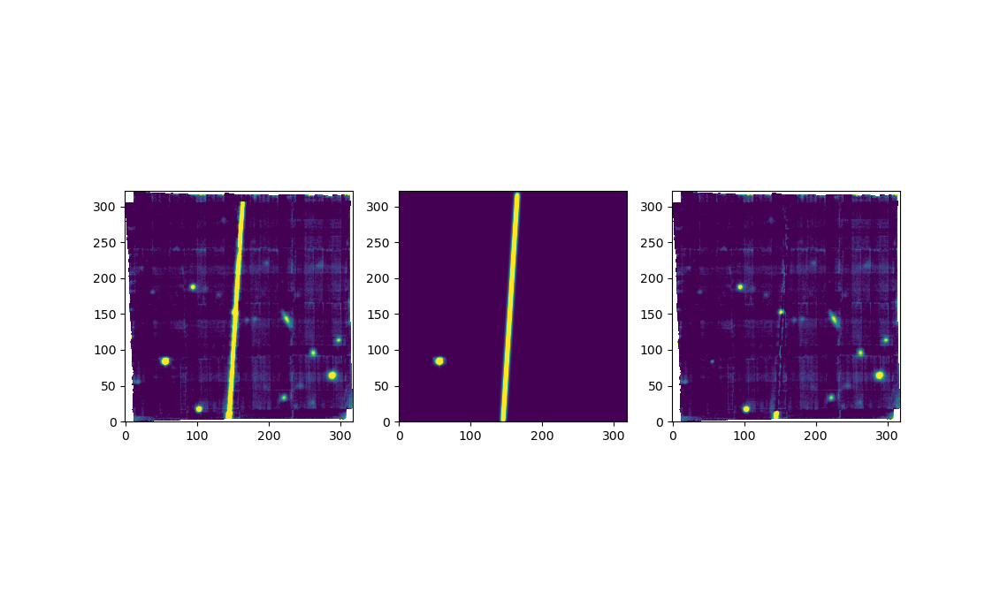

In [20]:
plt.figure()
plt.subplot(131)
plt.imshow(rawmed,origin='lower',vmin=0,vmax=10)
plt.subplot(132)
plt.imshow(modmed,origin='lower',vmin=0,vmax=10)
plt.subplot(133)
plt.imshow(diffmed,origin='lower',vmin=0,vmax=10)

In [88]:
plt.rc('text', usetex=True)
plt.rc('font', family='serif')

fig_width_pt = 240.0  # Get this from LaTeX using \showthe\columnwidth
inches_per_pt = 1.0/72.27               # Convert pt to inches
golden_mean = (np.sqrt(5)-1.0)/2.0         # Aesthetic ratio
fig_width = fig_width_pt*inches_per_pt  # width in inches

image = np.nanmedian(test.cube,axis=0)
scene = np.nanmedian(test.scene.sim,axis=0)
diff = np.nanmedian(test.diff,axis=0)



x = test.cat.xint + test.cat.x_offset
y = test.cat.yint + test.cat.y_offset

<IPython.core.display.Javascript object>


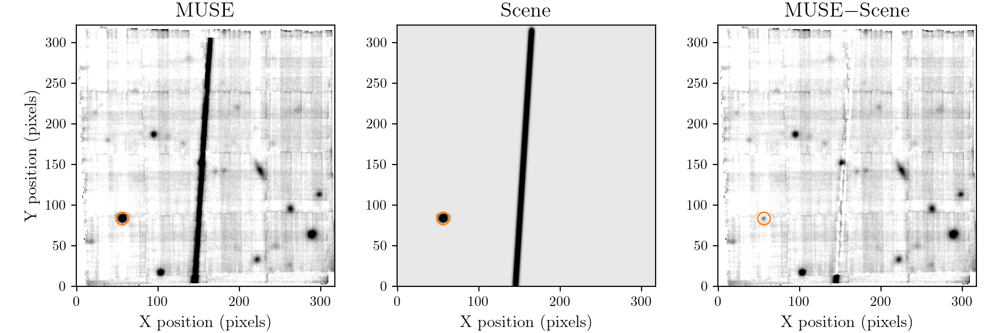

In [92]:
vmin = -1#np.nanpercentile(image,16)
vmax = 10#np.nanpercentile(image,84)

plt.figure(figsize=(1.5*fig_width*2,1*fig_width))
plt.subplot(131)
plt.title('MUSE',fontsize=15)
plt.imshow(image,origin='lower',vmin=vmin,vmax=vmax,cmap='gray_r')
plt.scatter(x, y, s=80, facecolors='none', edgecolors='C1')


plt.xlabel('X position (pixels)',fontsize=12)
plt.ylabel('Y position (pixels)',fontsize=12)

plt.subplot(132)
plt.title('Scene',fontsize=15)
plt.imshow(scene,origin='lower',vmin=vmin,vmax=vmax,cmap='gray_r')
plt.scatter(x, y, s=80, facecolors='none', edgecolors='C1')
plt.xlabel('X position (pixels)',fontsize=12)

plt.subplot(133)
plt.title('MUSE$ - $Scene',fontsize=15)
plt.imshow(diff,origin='lower',vmin=vmin,vmax=vmax,cmap='gray_r')
#plt.plot(x,y,'C1*',ms=5)
plt.scatter(x, y, s=80, facecolors='none', edgecolors='C1')
plt.xlabel('X position (pixels)',fontsize=12)


plt.tight_layout()
#plt.savefig('satellite_subtraction_example.pdf',bbox_inches='tight')

<IPython.core.display.Javascript object>


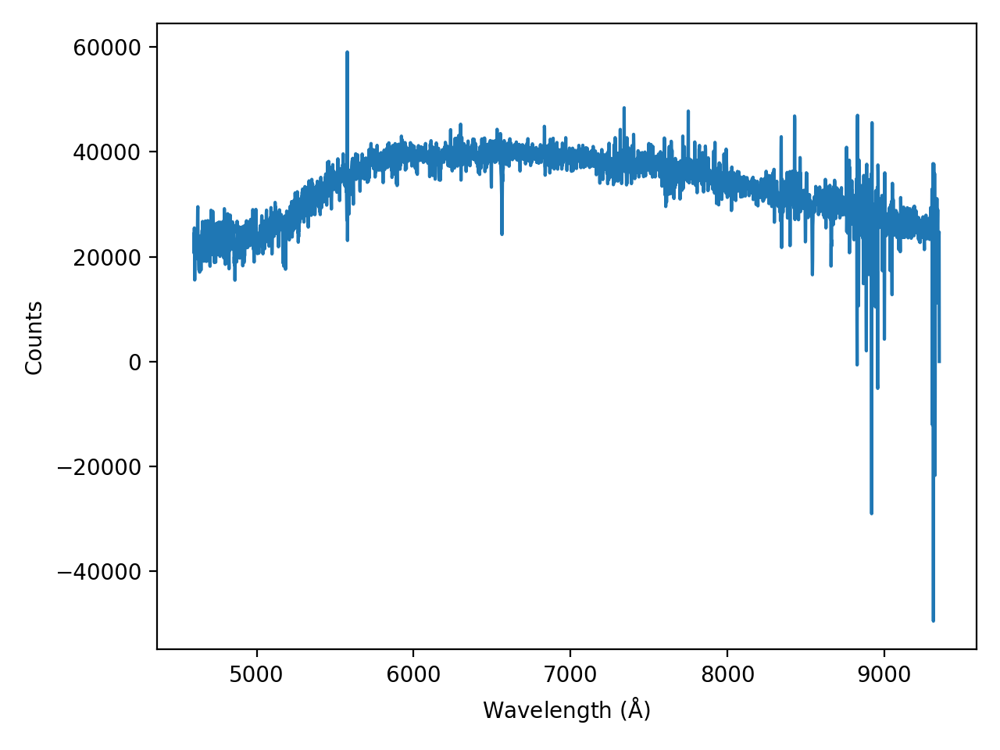

In [9]:
plt.figure()
plt.plot(test.lam,test.satellite.sat_fluxes[0])
plt.ylabel('Counts')
plt.xlabel(r'Wavelength ($\rm \AA$)')
plt.tight_layout()

In [10]:
a = cube_simulator(test.cube,psf=test.psf,catalogue=test.cat)

In [11]:
a.satellite = test.satellite

In [14]:
from skimage.util.shape import view_as_windows
def downSample2d(arr,sf):
    #isf2 = 1.0/(sf*sf) # Removed this factor since we don't want scaling
    (A,B) = arr.shape
    windows = view_as_windows(arr, (sf,sf), step = sf)
    return windows.sum(3).sum(2)#*isf2

seeds = []
x = a.satellite.satcat.x.values
y = a.satellite.satcat.y.values
for i in range(len(x)):
    xind = np.argmin(abs(a.X - x[i]))
    yind = np.argmin(abs(a.Y - y[i]))
    s = np.zeros_like(a.Sim) 
    s[yind,xind] = 1
    psf = a.satellite.sat_psfs[i]
    s = signal.fftconvolve(s,psf.longPSF,mode='same')
    s = downSample2d(s,a.repFact)
    s = s / np.nansum(s)
    seeds += [s]

In [16]:
seeds[0].shape

(362, 358)

<IPython.core.display.Javascript object>


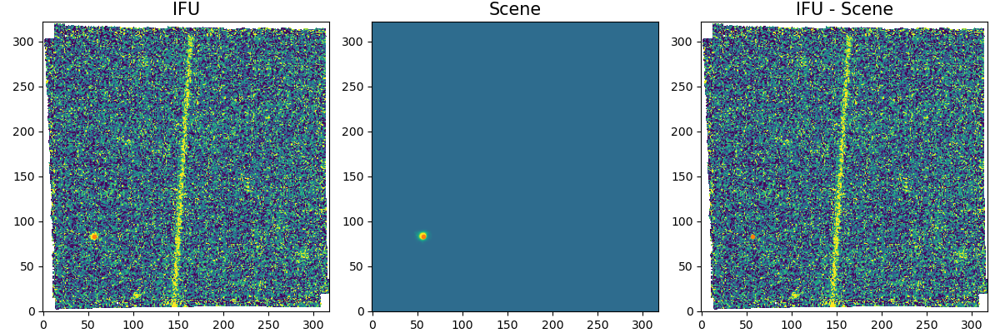

In [7]:
test.plot_diff()

<IPython.core.display.Javascript object>


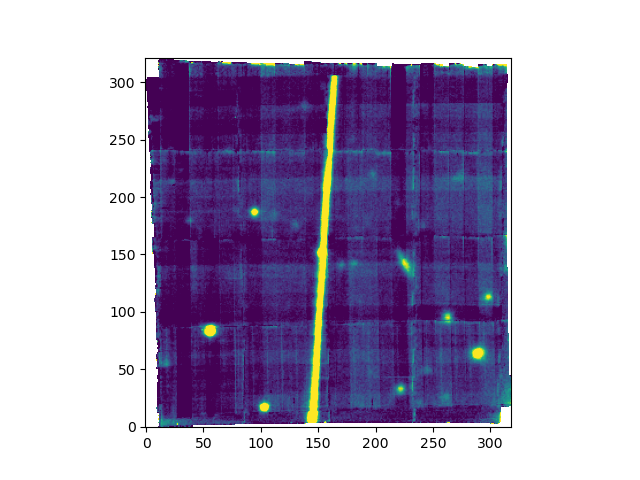

In [83]:
plt.figure()
plt.imshow(test.image,vmin=-1,vmax=10,origin='lower')

In [585]:
sato = sat_streaks(test.image,run=True,sigma=10,thickness=15)

In [347]:
sato.cut_dims

array([[ 15, 235]])

In [562]:
sato.image.shape

(322, 318)

In [563]:
test.cube[0].shape

(322, 318)

In [576]:
eh,_ = get_star_cuts(sato.cut_dims[0,0],sato.cut_dims[0,1],sato.image,sato.satcat,)
eh = eh[0]
#eh[np.isnan(eh)] = 0

In [532]:
psf2 = create_psf(sato.cut_dims[0,0]*2+1,sato.cut_dims[0,1]*2+1,angle = sato.angles[0],length = sato.lengths[0],)
psf = create_psf(sato.cut_dims[0,0]*2+1,sato.cut_dims[0,1]*2+1,angle = sato.angles[0],length = sato.lengths[0],stddev=test.psf.stddev)

In [534]:
psf.fit_psf(eh[0],limx=1,limy=1)


In [535]:
params = np.array([psf.stddev,psf.length,psf.angle])
shifts = np.array([psf.source_x,psf.source_y])

In [536]:
shifts

array([0.99995164, 0.99995164])

In [537]:
params

array([  4.99995687, 439.74067518,  88.99994866])

In [538]:
test.psf_param

array([2.21494094, 1.11856509, 0.        ])

In [539]:
psf.angle

88.99994865540596

In [494]:
psf2.generate_line_psf()
psf.generate_line_psf()

In [495]:
psf.source_y

9.999959801362373

In [501]:
np.where(psf.line2d)

(array([2355]), array([155]))

In [497]:
psf.repFact

10

<IPython.core.display.Javascript object>


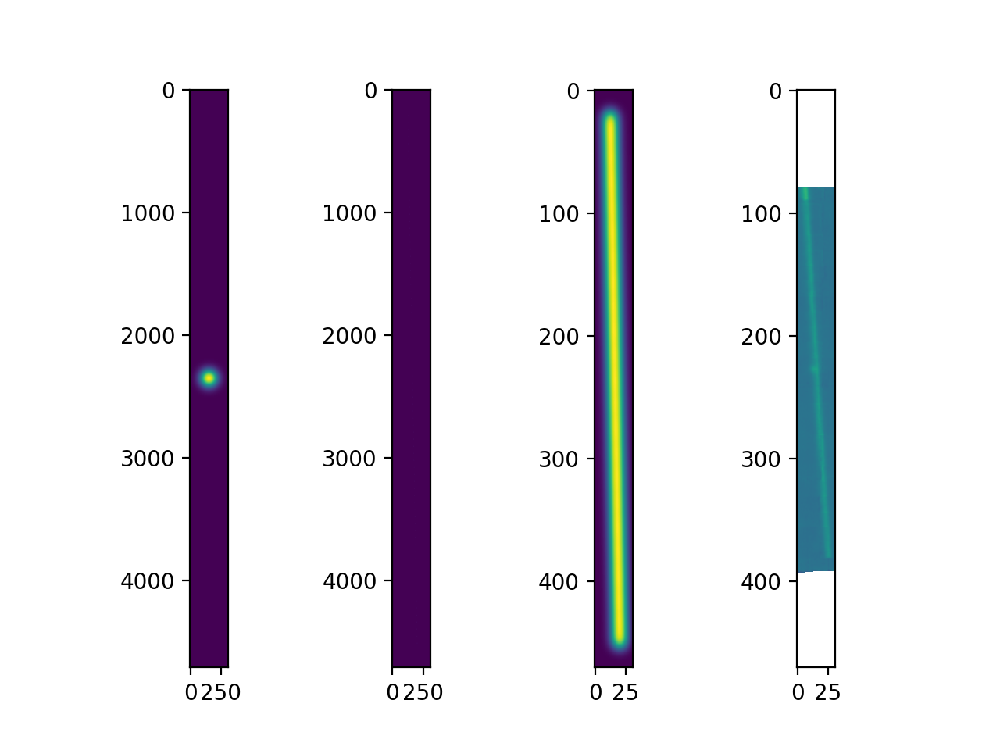

In [540]:
#a = signal.fftconvolve(psf.profile,psf.line2d,mode='same')
plt.figure()
plt.subplot(141)
plt.imshow(psf.profile)
plt.subplot(142)
plt.imshow(psf.line2d)
plt.subplot(143)
plt.imshow(psf.longpsf)
plt.subplot(144)
plt.imshow(eh)

In [527]:
psf.angle

88.99994865540596

In [530]:
psf.source_y

0.9999516354665013

In [523]:
psf.image_residual

array([[-1.96266992e-06, -3.14174526e-06, -4.83258259e-06, ...,
        -1.08400906e-07,  6.56451207e-17,  6.74442629e-17],
       [-4.48420529e-06, -7.17812166e-06, -1.10413141e-05, ...,
        -2.47772069e-07,  5.63734574e-17,  5.87001808e-17],
       [-9.84720447e-06, -1.57630529e-05, -2.42466833e-05, ...,
        -5.44387189e-07,  4.88911511e-17,  5.01197631e-17],
       ...,
       [ 6.68637234e-17,  6.72581363e-17,  6.80656070e-17, ...,
        -2.41523390e-04, -1.70726664e-04, -1.15965384e-04],
       [ 6.81551537e-17,  6.68241571e-17,  6.61060207e-17, ...,
        -1.19480442e-04, -8.44583508e-05, -5.73684631e-05],
       [ 6.07766958e-17,  5.57478740e-17,  5.12803396e-17, ...,
        -5.68202444e-05, -4.01653688e-05, -2.72825685e-05]])

In [547]:
psf.angle = psf.angle_o
psf.stddev = test.psf.stddev

In [566]:
sat,_ = get_star_cuts(sato.cut_dims[0,0],sato.cut_dims[0,1],test.cube[1000],sato.satcat,)
sat = sat[0]

In [580]:
f, r = psf.psf_flux(sat)


In [577]:
psf.fit_pos(eh)

In [579]:
psf.source_y

0.9088797723979464

<IPython.core.display.Javascript object>


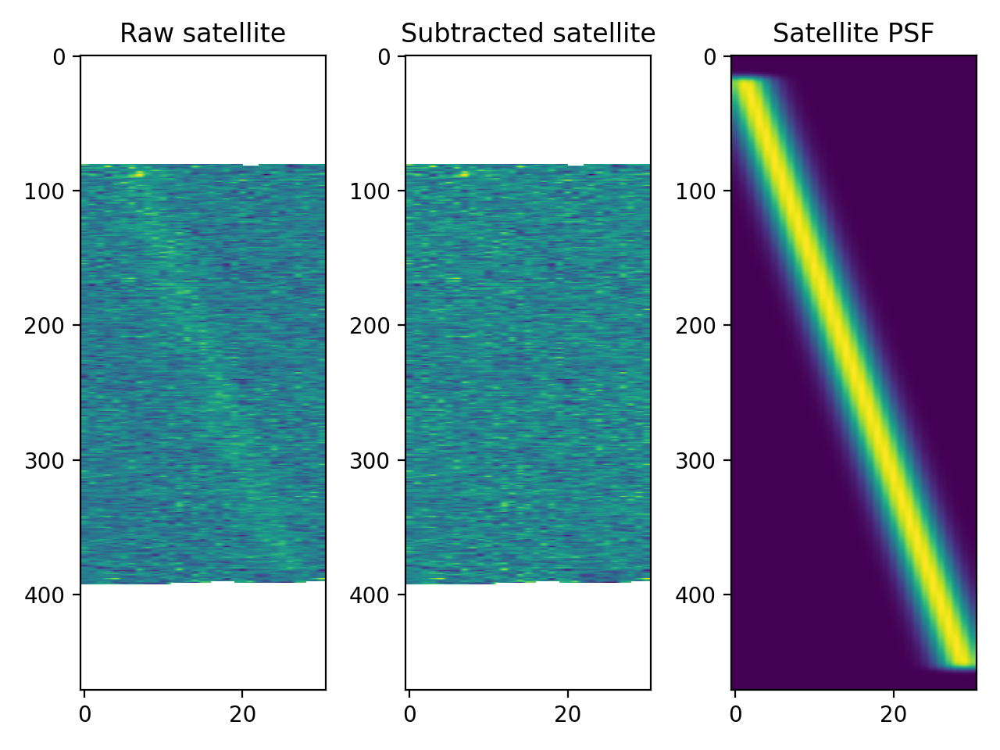

In [581]:
plt.figure()
plt.subplot(131)
plt.title('Raw satellite')
plt.imshow(sat,aspect='auto')
plt.subplot(132)
plt.imshow(psf.image_residual,aspect='auto')
plt.title('Subtracted satellite')
plt.subplot(133)
plt.imshow(psf.longpsf,aspect='auto')
plt.title('Satellite PSF')
plt.tight_layout()

<IPython.core.display.Javascript object>


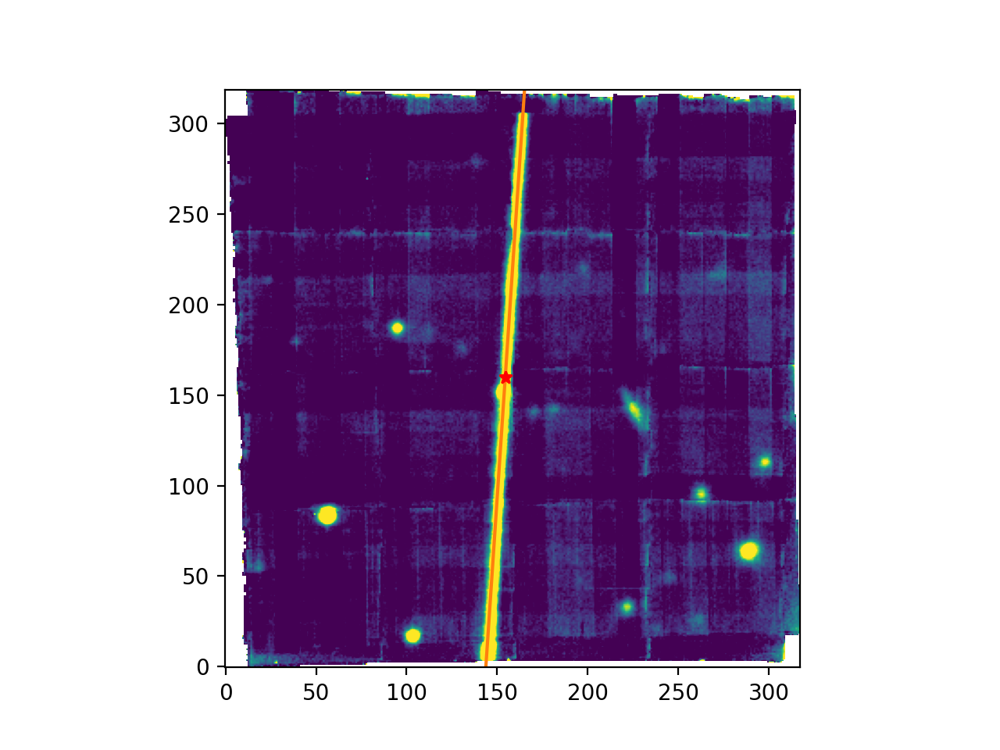

In [292]:
sato.plot_lines()
plt.plot(sato.centers[0][0],sato.centers[0][1],'r*')

In [296]:
sato.angles

array([86.34852561])

<IPython.core.display.Javascript object>


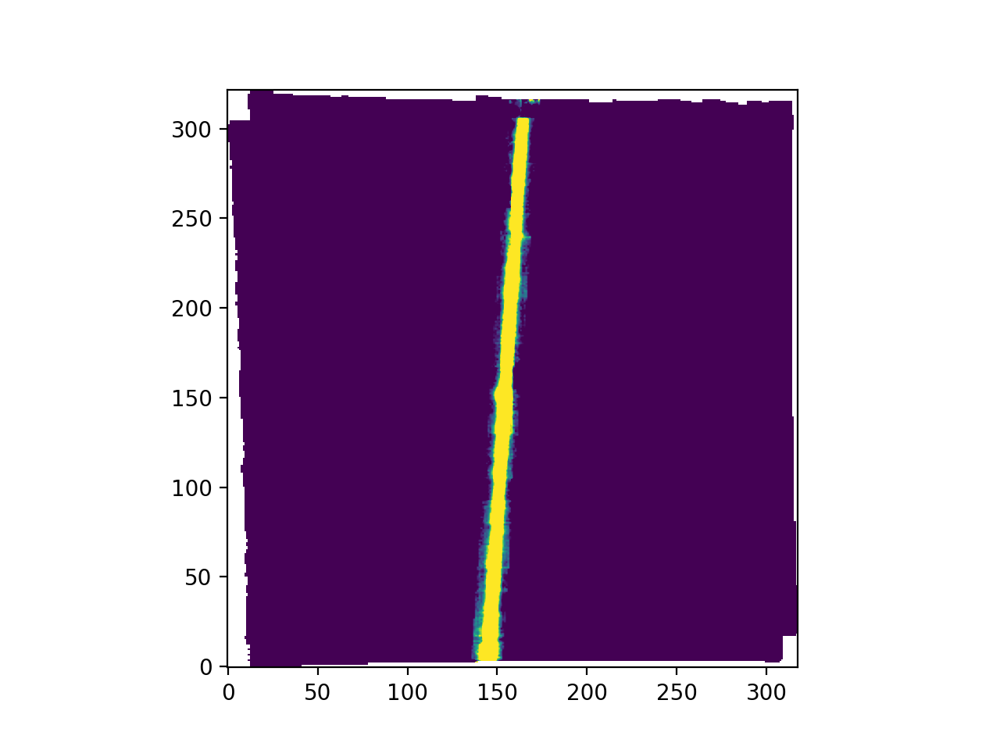

In [289]:
plt.figure()
plt.imshow(sato.total_mask * sato.image,origin='lower',vmin=0,vmax=5)

In [18]:
sato = satellite_killer(test.cube,test.psf)

In [19]:
sato._fit_spec()

In [21]:
sato.satcat

,xint,yint,x,y
0,154,160,154.703562,157.632034


In [24]:
sato.sat_fluxes

array([[ 1329.18549953,  6551.25333076,  7595.70835836, ...,
        53979.73164177, 49406.20105498, 42935.35557089]])

In [23]:
sato.streak_coef

array([[   17.88888889, -2695.22222222],
       [   15.2047619 , -2158.21904762]])

In [17]:
import numpy as np
import cv2
from copy import deepcopy
from astropy.stats import sigma_clipped_stats
class satellite_killer():
    def __init__(self,cube,psf,sat_thickness=17,sat_sigma=15,y_close=5,angle_close=2,num_cores=5,run=True):
        self.cube = cube
        self.star_psf = psf
        self._make_image()
        self._set_threshold(sat_sigma)
        self.thickness = sat_thickness
        self.y_close = y_close
        self.angle_close = angle_close
        self.num_cores = num_cores

        if run:
            self._dilate()
            self._edges()
            self._lines()
            self._match_lines()
            self._find_center()
            self.make_mask()
            self._detected()
            if self.sat_num > 0:
                self.make_satellite_psf()
                #self._fit_spec()

    def _make_image(self):
        image = np.nanmedian(self.cube,axis=0)
        self.image = image - np.nanmedian(image)
    
    
    def _set_threshold(self,sigma):
        mean, med, std = sigma_clipped_stats(self.image)
        self.threshold = mean + sigma*std

    def _detected(self):
        if len(self.streak_coef) > 0:
            self.satellite = True
        else:
            self.satellite = False
        self.sat_num = len(self.streak_coef)

    def _dilate(self):
        # set all values below the threshold to zero
        arr = deepcopy(self.image)
        arr[arr < self.threshold] = 0

        # create a structuring element for morphological dilation
        kernel = np.ones((9, 9))

        # dilate the array
        dilated = cv2.dilate(arr, kernel, iterations=1)
        dilated[dilated<10]  = 0
        # set all non-zero values in the dilated array that are not connected to other non-zero values to zero
        arr[(arr != 0) & (dilated == 0)] = 0

        d = (dilated > 0) * 1
        self.gray = (d*255/np.max(d)).astype('uint8')
        
    def _edges(self):
        low_threshold = 50
        high_threshold = 150
        self.edges = cv2.Canny(self.gray, low_threshold, high_threshold)

    def _lines(self):
        lines = cv2.HoughLinesP(self.edges, # Input edge image
                                1, # Distance resolution in pixels
                                np.pi/180, # Angle resolution in radians
                                threshold=100, # Min number of votes for valid line
                                minLineLength=100, # Min allowed length of line
                                maxLineGap=50 # Max allowed gap between line for joining them
                                )
        if lines is not None:
            good = []
            for i in range(len(lines)):
                line = lines[i]
                x1, y1, x2, y2 = line[0]
                # calculate the angle of the line
                angle = np.arctan2(y2 - y1, x2 - x1) * 180 / np.pi
                #if abs(angle) < 85:
                good += [i]
            good = np.array(good,dtype=int)

            self.lines = lines[good]
        else:
            self.lines = []
    
    

    def _match_lines(self,y_close=None,angle_close=None):
        if y_close is None:
            y_close = self.y_close
        if angle_close is None:
            angle_close = self.angle_close
            
        coefs = []
        xs = []
        ys = []
        for line in self.lines:
            x1, y1, x2, y2 = line[0]
            xs += [[x1,x2]]
            ys += [[y1,y2]]
            coefs += [np.polyfit([x1,x2], [y1,y2], 1)]
        coefs = np.array(coefs)
        xs = np.array(xs); ys = np.array(ys)
        xx = np.arange(np.min(xs),np.max(xs),1)
        yy = []
        for c in coefs:
            yy += [xx*c[0]+c[1]]
        yy = np.array(yy)


        new_coefs = []

        used = np.zeros(len(yy))
        for i in range(len(yy)):
            if not used[i]:
                diff = abs(yy[np.newaxis,i] - yy)
                diff = np.nanmedian(diff,axis=1)
                ind = diff < y_close
                new_coefs += [np.nanmean(coefs[ind],axis=0)]
                used[ind] = 1

        new_coefs = np.array(new_coefs)
        yy = []
        for c in new_coefs:
            yy += [xx*c[0]+c[1]]
        yy = np.array(yy)
        n_coefs = []

        used = np.zeros(len(yy))
        angle = np.arctan(new_coefs[:,0])
        for i in range(len(yy)):
            if not used[i]:
                diff = abs(angle[i] - angle)
                ind = diff < angle_close
                n_coefs += [np.nanmean(new_coefs[ind],axis=0)]
                used[ind] = 1
        n_coefs = np.array(n_coefs)

        self.streak_coef = n_coefs
        
        self._find_center()

    def plot_lines(self):
        plt.figure()
        plt.imshow(self.image,origin='lower',vmax=10,vmin=0)
        #for line in self.lines:
        #    x1, y1, x2, y2 = line[0]
        #    plt.plot([x1,x2],[y1,y2],'C1')
        for c in self.streak_coef:
            xx = np.arange(0,self.image.shape[1],0.5)
            yy = xx*c[0] + c[1]
            plt.plot(xx,yy,'C1')
        plt.ylim(-0.5,self.image.shape[1]+0.5)
        
    def _find_center(self):
        centers = []
        lengths = []
        angles = []
        cut_dims = []
        for c in self.streak_coef:
            xx = np.arange(0,self.image.shape[1],0.5)
            yy = xx*c[0] + c[1]
            ind = (yy > 0) & (yy < self.image.shape[0])
            yy = yy[ind]; xx = xx[ind]
            centers += [[np.nanmean(xx),np.nanmean(yy)]]
            lengths += [np.sqrt((xx[0]-xx[-1])**2 + (yy[0] - yy[-1])**2)]
            angles += [np.arctan2(yy[-1] - yy[0], xx[-1] - xx[0]) * 180 / np.pi]
            cut_dims += [[abs(xx[0] - xx[-1])/2,abs(yy[0]-yy[-1])/2]]
        self.centers = np.array(centers)
        self.lengths = np.array(lengths)
        self.angles = np.array(angles)
        self.cut_dims = (np.array(cut_dims) * 1.5).astype(int)
        
        satcat = pd.DataFrame([])
        satcat['xint'] = self.centers[:,0].astype(int)
        satcat['yint'] = self.centers[:,1].astype(int)
        self.satcat = satcat
        
    
    def make_mask(self,thickness=None):
        if thickness is None:
            thickness = self.thickness
        # create a black image with the same size as the input image
        mask = np.zeros_like(self.image)

        # loop through the consolidated lines
        sat_mask = []
        for c in self.streak_coef:
            xx = np.arange(0,self.image.shape[1],0.5)
            yy = xx*c[0] + c[1]
            ind = (yy > 0) & (yy < self.image.shape[0])
            yy = yy[ind]; xx = xx[ind]
            
            tmp = cv2.line(mask, (int(xx[0]), int(yy[0])), (int(xx[-1]), int(yy[-1])), (255, 255, 255), thickness=thickness)
            tmp[tmp > 0] = 1
            sat_mask += [tmp]

        # The pixels that are covered by the line will have a value of 8 in the mask
        # You can use this mask to extract the pixels that belong to the lines
        sat_mask = np.array(sat_mask).astype(int)
        if len(sat_mask) == 0:
            sat_mask = mask
        
        self.mask = sat_mask

        tmp = np.nansum(self.mask,axis=0)
        tmp[tmp > 0] = 1
        self.total_mask = tmp.astype(int)
        
    def make_satellite_psf(self):
        self.sat_psfs = []
        for i in range(self.sat_num):
            if 'gaussian' in self.star_psf.psf_profile:
                self.sat_psfs += [create_psf(self.cut_dims[0,0]*2+1,self.cut_dims[0,1]*2+1,angle = self.angles[0],
                                           length = self.lengths[0],stddev=test.psf.stddev)]
            elif 'moffat' in self.star_psf.psf_profile:
                self.sat_psfs += [create_psf(self.cut_dims[0,0]*2+1,self.cut_dims[0,1]*2+1,angle = self.angles[0],
                                           length = self.lengths[0],alpha=test.psf.alpha,beta=test.psf.beta)]
        
            
            
    def _fit_spec(self):
        sat_fluxes = []
        self.satcat['x'] = 0; self.satcat['y'] = 0
        for i in range(self.sat_num):
            cut = cube_cutout(self.cube,self.satcat.iloc[i],self.cut_dims[i,0],self.cut_dims[i,1])[0]
            psf = self.sat_psfs[i]
            psf.fit_pos(np.nanmean(cut,axis=0),range=5)
            xoff = psf.source_x; yoff = psf.source_y

            flux,res = zip(*Parallel(n_jobs=self.num_cores)(delayed(psf.psf_flux)(image) for image in cut))
            sat_fluxes += [np.array(flux)]
            
            self.satcat['x'].iloc[i] = self.satcat['xint'].values + xoff
            self.satcat['y'].iloc[i] = self.satcat['yint'].values + yoff
        self.sat_fluxes = np.array(sat_fluxes)
            

In [485]:
import numpy as np
import matplotlib.pyplot as plt
from scipy.optimize import minimize, least_squares
from scipy import signal
from skimage.util.shape import view_as_windows
from copy import deepcopy
from astropy.modeling.functional_models import Gaussian2D
from scipy.ndimage import shift
from scipy.interpolate import griddata

def downSample2d(arr,sf):
    """
    Downsample an array by a factor of sf.

    Parameters
    ----------
    arr : 2d numpy array
        Input array to be downsampled.
    sf : int
        Downsample factor.

    Returns
    -------
    arr_ds : 2d numpy array
        Downsampled array.
    """
    isf2 = 1.0/(sf*sf)
    (A,B) = arr.shape
    windows = view_as_windows(arr, (sf,sf), step = sf)
    return windows.sum(3).sum(2)*isf2

class create_psf():
    def __init__(self,x,y,angle,length,alpha=3.8,beta=4.765,stddev=2,
                 repFact=10,verbose=False,psf_profile='gaussian'):
        """
        Create a PSF object that can be used for both non-siderial and sidrial tracking.
        This class is built from the TRIPPY package.

        Parameters
        ----------
        x : int or 1d numpy array
            x dimension of the PSF
        y : int or 1d numpy array
            y dimension of the PSF
        angle : float
            Angle of motion of the object in degrees.
        length : float
            Length of the exposure in the same units as the rate.
        alpha : float
            Alpha parameter of the moffat profile.
        beta : float
            Beta parameter of the moffat profile.
        stddev : float
            Standard deviation of the gaussian profile.
        repFact : int
            Replication factor for the PSF. PSF will be downsampled by this factor.
        verbose : bool
            Verbose output.
        psf_profile : str
            Profile of the PSF. Options are 'gaussian' or 'moffat'.

        Returns
        -------
        psf : object
            PSF object.

        Examples
        --------
        >>> psf = create_psf(100,100,angle=10,length=10,repFact=10)
        >>> psf.fit_psf(image)
        >>> psf.psf_fig()
        """
        self.A=None
        self.alpha=alpha
        self.beta=beta
        self.stddev = stddev
        self.chi=None
        self.rate = None
        self.angle = deepcopy(angle)
        self.angle_o = deepcopy(angle)
        self.length = deepcopy(length)
        self.length_o = deepcopy(length)
        self.source_x = 0
        self.source_y = 0
        self._set_psf_profile(psf_profile)

        if type(x)!=type(np.ones(1)):
            self.x=np.arange(x)+0.5
            self.y=np.arange(y)+0.5
        elif len(x)==1:
            self.x=np.arange(x)+0.5
            self.y=np.arange(y)+0.5
        else:
            self.x=x*1.0+0.5
            self.y=y*1.0+0.5
        self.cent=np.array([len(self.y)/2.,len(self.x)/2.])
        self.centx=self.cent[1]
        self.centy=self.cent[0]
        self.repFact=repFact

        self.psf=np.ones([len(self.y),len(self.x)]).astype('float')

        self.inds=np.zeros((len(self.y),len(self.x),2)).astype('int')
        for ii in range(len(self.y)):
            self.inds[ii,:,1]=np.arange(len(self.x))
        for ii in range(len(self.x)):
            self.inds[:,ii,0]=np.arange(len(self.y))

        self.coords=self.inds+np.array([0.5,0.5])
        self.r=np.sqrt(np.sum((self.coords-self.cent)**2,axis=2))


        self.X=np.arange(len(self.x)*self.repFact)/float(self.repFact)+0.5/self.repFact
        self.Y=np.arange(len(self.y)*self.repFact)/float(self.repFact)+0.5/self.repFact
        self.XX, self.YY = np.meshgrid(self.X-self.centx,self.Y-self.centy)
        self.Inds=np.zeros((len(self.y)*self.repFact,len(self.x)*self.repFact,2)).astype('int')
        for ii in range(len(self.y)*self.repFact):
            self.Inds[ii,:,1]=np.arange(len(self.x)*self.repFact)
        for ii in range(len(self.x)*self.repFact):
            self.Inds[:,ii,0]=np.arange(len(self.y)*self.repFact)
        self.Coords=(self.Inds+np.array([0.5,0.5]))/float(self.repFact)

        self.R=np.sqrt(np.sum((self.Coords-self.cent)**2,axis=2))

        #if 'moffat' in self.psf_profile:
        self.PSF=self.moffat(self.R)
        #elif 'gaussian' in self.psf_profile:
         #   self.PSF=self.gauss2d(self.R)

        self.PSF/=np.sum(self.PSF)
        self.psf=downSample2d(self.PSF,self.repFact)

        self.fullPSF=None
        self.fullpsf=None


        self.shape=self.psf.shape

        self.aperCorrFunc=None
        self.aperCorrs=None
        self.aperCorrRadii=None
        self.lineAperCorrFunc=None
        self.lineAperCorrs=None
        self.lineAperCorrRadii=None

        self.verbose=verbose
        self.fitted=False

        self.lookupTable=None
        self.lookupF=None
        self.lookupR=None
        #self.rDist=None
        #self.fDist=None

        self.line2d=None
        #self.longPSF=None
        #self.longpsf=None

        self.bgNoise=None


        #from fitting a psf to a source
        self.model=None
        self.residual=None

        self.psfStars=None


    def _set_psf_profile(self,prof):
        """
        Set the PSF profile.

        Parameters
        ----------
        prof : str
            Profile of the PSF. Options are 'gaussian' or 'moffat'.

        """
        options = ['gaussian','moffat']
        if (options[0] in prof.lower()) | (options[1] in prof.lower()):
            self.psf_profile = prof
        else:
            m = f'{prof} is not an accepted option. Please choose from: {options}'
            raise ValueError(m)

    def moffat(self,rad):
        """
        Return a moffat profile evaluated at the radii in the input numpy array.

        Parameters
        ----------
        rad : 1d numpy array
            Radii at which to evaluate the moffat profile.

        Returns
        -------
        moffat : 1d numpy array
            Moffat profile evaluated at the input radii.
        """

        #normalized flux profile return 1.-(1.+(rad/self.alpha)**2)**(1.-self.beta)
        a2=self.alpha*self.alpha
        return (self.beta-1)/(np.pi*a2)*(1.+(rad/self.alpha)**2)**(-self.beta)

    def gauss2d(self,x,y):
        """
        Return a 2d gaussian profile evaluated at the input x and y coordinates.

        Parameters
        ----------
        x : 2d numpy array
            x coordinates at which to evaluate the gaussian profile.
        y : 2d numpy array
            y coordinates at which to evaluate the gaussian profile.

        Returns
        -------
        g : 2d numpy array
            2d gaussian profile evaluated at the input coordinates.
        """
        g2d = Gaussian2D(x_stddev=self.stddev,y_stddev=self.stddev)
        g = g2d(x,y)
        return g


    def generate_line_psf(self,angle=None,length=None,shiftx=0,shifty=0, verbose=False):
        """
        Generate a PSF for a given angle and length.

        Parameters
        ----------
        angle : float
            Angle of the object relative to the x axis
        length : float
            Length of trail.
        shiftx : float
            Shift in the x direction.
        shifty : float
            Shift in the y direction.
        verbose : bool
            Verbose output.
        """

        if angle is not None:
            self.angle=angle
        if length is not None:
            self.length=length
        angr = self.angle*np.pi/180.


        self.line2d=self.PSF*0.0
        centx_s = self.centx + shiftx
        centy_s = self.centy + shifty
        w=np.where(np.abs(self.X-centx_s) < np.cos(angr)*(self.length/2.))
        if len(w[0])>0:
            x=self.X[w]*1.0
            y=np.tan(angr)*(x-centx_s) + centy_s
            X=(x*self.repFact).astype('int')
            Y=(y*self.repFact).astype('int')
            ind = (X >= 0) & (X < self.line2d.shape[1]) & (Y >= 0) & (Y < self.line2d.shape[0])
            self.line2d[Y[ind],X[ind]]=1.0

            w=np.where(self.line2d>0)
            yl,yh=np.min(w[0]),np.max(w[0])
            xl,xh=np.min(w[1]),np.max(w[1])
        
            #self.line2d=self.line2d[yl:yh+1,xl:xh+1]

        else:
            self.line2d[int(centy_s*self.repFact),int(centx_s*self.repFact)] = 1

        #if line_width > 1:
        #   k = np.zeros((int(line_width),int(line_width)))
        #   self.line2d = signal.fftconvolve(k,self.line2d,mode='same')
        #   self.line2d[self.line2d > 0] = 1
        #self.longPSF=signal.convolve2d(self.moffProf,self.line2d,mode='same')
        if 'gaussian' in self.psf_profile:
            self.profile = self.gauss2d(self.XX,self.YY)
        elif 'moffat' in self.psf_profile:
            self.profile = self.moffat(self.R-np.min(self.R))

        self.longPSF = signal.fftconvolve(self.profile,self.line2d,mode='same')
        self.longPSF *= np.sum(self.profile)/np.sum(self.longPSF)
        self.longPSF /= np.nansum(self.longPSF)
        self.longpsf = downSample2d(self.longPSF,self.repFact)
        self.longpsf /= np.nansum(self.longpsf)
        self._linepsf = downSample2d(self.line2d,self.repFact)

    def psf_fig(self):
        """
        Plot the PSF.
        """
        plt.figure()
        plt.imshow(self.longpsf,origin='lower')
        plt.colorbar()

    def minimizer(self,coeff,image):
        """
        Minimizer function for fitting a PSF to an image.

        Parameters
        ----------
        coeff : 1d numpy array
            Parameters for the minimizer.
        image : 2d numpy array
            Image to fit the PSF to.

        Returns
        -------
        residual : float
            Residual of the minimizer.
        """
        #print(coeff)
        if  'moffat' in self.psf_profile:
            self.alpha = coeff[0]
            self.beta = coeff[1]
            self.length = coeff[2]
            self.angle = coeff[3]
            self.source_x = coeff[4]
            self.source_y = coeff[5]
            #floor = coeff[6]
        elif 'gaussian' in self.psf_profile:
            self.stddev = coeff[0]
            self.length = coeff[1]
            self.angle = coeff[2]
            self.source_x = coeff[3]
            self.source_y = coeff[4]
            #floor = coeff[5]
        self.generate_line_psf(shiftx = self.source_x, shifty = self.source_y)
        psf = self.longpsf / np.nansum(self.longpsf) # type: ignore
        
        diff = abs(image - psf)
        residual = np.nansum(diff)
        #self.residual = residual
        return np.exp(residual)


    def fit_psf(self,image,limx=10,limy=10):
        """
        Fit a PSF profile to the input image.

        Parameters
        ----------
        image : numpy array
            image of target to fit the PSF to 
        limx : float
            limit for fitting in the x shift 
        limy : float
            limit for fitting in the y shift 
        """
        

        image -= np.nanmedian(image)
        normimage = image / np.nansum(image)
        anglebs = [self.angle_o*0.6,self.angle_o*1.4]
        minang = np.min(anglebs); maxang = np.max(anglebs)
        if maxang >89: 
            maxang = 89
        if minang < -89:
            minang = -89

        if self.psf_profile == 'moffat':
            coeff = [self.alpha,self.beta,self.length,self.angle,0,0]
            lims = [[0.1,100],[1,100],[self.length_o*0.6,self.length_o*1.4],
                    [minang,maxang],[-limx,limx],[-limy,limy]]
        elif self.psf_profile == 'gaussian':
            coeff = [self.stddev,self.length,self.angle,0,0]
            lims = [[0.1,5],[self.length_o*0.6,self.length_o*1.4],
                    [minang,maxang],[-limx,limx],[-limy,limy]]
        else:
            m = 'Incorrect psf_profile, please select from moffat or gaussian.'
            raise ValueError(m)
        #lims = [[-100,100],[-100,100],[5,20],[-80,80],[-limx,limx],[-limy,limy]]
        #res = least_squares(self.minimizer,coeff,args=normimage,method='trf',x_scale=0.1)
        res = minimize(self.minimizer, coeff, args=normimage, method='Powell',bounds=lims)
                        #jac = '2-point',options={'finite_diff_rel_step':0.1})
        self.psf_fit = res

    def make_data_psf(self,data_cuts):
        """
        Create a PSF using the calibration stars. This does a better job for longer exposures with scintilation.

        Parameters
        ----------
        data_cuts : numpy array 
            cuts of the image that contain the target stars PSF
        """
        psf_mask = (self.longpsf > 1e-6) * 1
        data_cuts *= psf_mask[np.newaxis,:,:]
        data_cuts[np.isnan(data_cuts)] = 0.0
        medcuts = data_cuts / np.nanmax(data_cuts,axis=(1,2))[:,np.newaxis,np.newaxis]
        sm = np.zeros_like(medcuts)
        for i in range(len(medcuts)):
            self.fit_pos(medcuts[i],data=False)
            sm[i] = shift(medcuts[i],[-self.source_y,-self.source_x],mode='nearest')
        data_psf = np.nanmedian(sm,axis=0)    
        self.data_psf = data_psf / np.nansum(data_psf)
        self.data_psf[self.data_psf < 1e-6] = 0

        x = np.arange(0,self.data_psf.shape[1])
        y = np.arange(0,self.data_psf.shape[0])
        xx, yy = np.meshgrid(x, y)
        XX, YY = np.meshgrid(self.X-0.5,self.Y-0.5)

        estimate = griddata((xx.ravel(), yy.ravel()), self.data_psf.ravel(),
                            (XX.ravel(),YY.ravel()),method='linear',fill_value=0)

        estimate = estimate.reshape(len(self.Y),len(self.X))
        estimate[estimate < 1e-5] = 0
        self.data_PSF = estimate
        self.source_x = 0; self.source_y = 0
        self.generate_line_psf()




    def minimize_pos(self,coeff,image,data=True):
        """
        Minimizer function for fitting the position of the source to an image.

        Parameters
        ----------
        coeff : 1d numpy array
            Parameters for the minimizer.
        image : 2d numpy array
            Image to fit the position of the source to.

        Returns
        -------
        residual : float
            Residual of the minimizer.
        """

        if ('data' in self.psf_profile) & data:
            if self.data_psf is not None:
                self.longpsf = shift(self.data_psf,[coeff[1],coeff[0]],mode='nearest')
            else:
                raise ValueError('No data psf defined! Use the make_data_psf function first.')
        else:
            self.generate_line_psf(shiftx = coeff[0], shifty = coeff[1])

        psf = self.longpsf / np.nansum(self.longpsf)
        diff = abs(image - psf)
        residual = np.nansum(diff)
        return np.exp(residual)
        
    def fit_pos(self,image,range=5,data=True):
        """
        Fit the position of the source to the input image.

        Parameters
        ----------
        image : 2d numpy array
            Image to fit the position of the source to.
        range : float
            Range to fit the position of the source over.

        Returns
        -------
        source_x : float
            Source x position.
        source_y : float
            Source y position.
        
        """
        normimage = image / np.nansum(image)
        coeff = [0,0]
        lims = [[-range,range],[-range,range]]
        res = minimize(self.minimize_pos,coeff, args=(normimage,data), method='Powell',bounds=lims)
        self.source_x = res.x[0]
        self.source_y = res.x[1]
        if ('data' in self.psf_profile) & data:
            self.longpsf = self.data_psf
        else:
            self.generate_line_psf(shiftx = 0, shifty = 0)

    
        
    def minimize_psf_flux(self,coeff,image):
        """
        Minimizer function for fitting the flux of the PSF to an image.

        Parameters
        ----------
        coeff : 1d numpy array
            Parameters for the minimizer.
        image : 2d numpy array
            Image to fit the PSF to.

        Returns
        -------
        residual : float
            Residual of the minimizer.
        """ 
        res = np.nansum(abs(image - self.longpsf*coeff[0]))
        return res

    def psf_flux(self,image,output = True):
        """
        Fit the flux of the PSF to the input image.

        Parameters
        ----------
        image : 2d numpy array
            Image to fit the PSF to.

        Returns
        -------
        flux : float
            Flux of the PSF.
        image_residual : 2d numpy array
            Residual image after subtracting the PSF from the input image.
        """
        if self.longpsf is None:
            self.generate_line_psf()
        mask = np.zeros_like(self.longpsf)
        mask[self.longpsf > np.nanpercentile(self.longpsf,70)] = 1 # type: ignore
        f0 = np.nansum(image*mask)
        bkg = np.nanmedian(image[~mask.astype(bool)])
        image = image - bkg
        if 'data' in self.psf_profile:
            if self.data_psf is not None:
                self.longpsf = shift(self.data_psf,[self.source_y,self.source_x],mode='nearest')
            else:
                raise ValueError('No data psf defined! Use the make_data_psf function first.')
        else:
            self.generate_line_psf(shiftx=self.source_x,shifty=self.source_y)
        res = minimize(self.minimize_psf_flux,f0,args=(image),method='Nelder-Mead')
        self.flux = res.x[0]
        self.image_residual = image - self.longpsf*self.flux

        if 'data' in self.psf_profile:
                self.longpsf = self.data_psf
        else:
            self.generate_line_psf(shiftx=0,shifty=0)

        #if output:
        return self.flux, self.image_residual





In [310]:
satcat

,xint,yint
0,154,159


In [303]:
sato.centers[:,0]

array([154.5])

In [304]:
sato.centers

array([[154.5   , 159.8125]])

In [115]:
x = points[:,0]
y = points[:,1]

coefs = np.polyfit(x, y, 1)
slope = coefs[0]
intercept = coefs[1]
x1 = np.min(x)
xx = np.arange(np.min(x),np.max(x))
y1 = int(slope * x1 + intercept)
x2 = np.max(x)
y2 = int(slope * x2 + intercept)
yy = (slope * xx + intercept).astype(int)

<IPython.core.display.Javascript object>


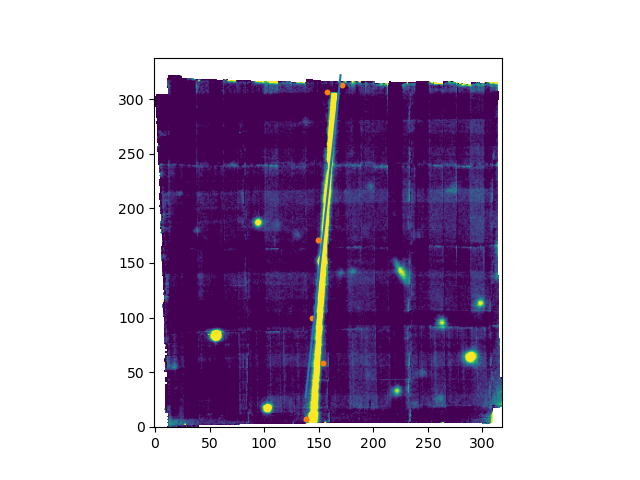

In [118]:
plt.figure()
#plt.imshow(np.flip(sato.mask[0]) * test.image,origin='lower',vmax=10)
plt.imshow(test.image,origin='lower',vmax=10,vmin=0)
plt.plot(x,y,'C1.')
plt.plot(x,y,'C1.')
plt.plot(xx,yy)

In [123]:
points = []
for line in lines:
    for x1, y1, x2, y2 in line:
        points.append(((x1 + 0.0, y1 + 0.0), (x2 + 0.0, y2 + 0.0)))
        cv2.line(sato.edges, (x1, y1), (x2, y2), (255, 0, 0), 5)

<IPython.core.display.Javascript object>


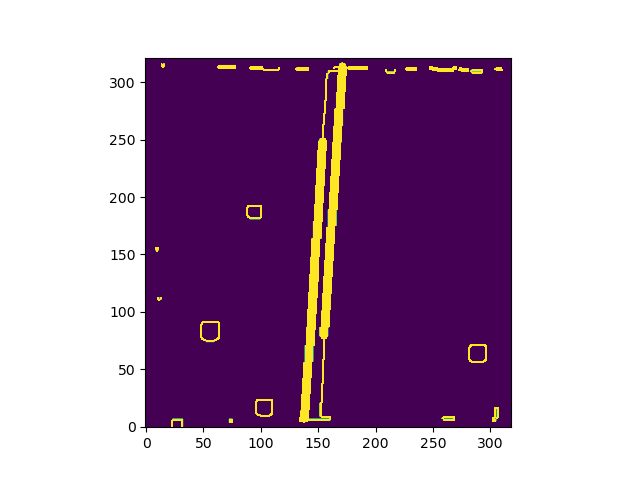

In [124]:
plt.figure()
#plt.imshow(np.flip(sato.mask[0]) * test.image,origin='lower',vmax=10)
plt.imshow(sato.edges,origin='lower',vmax=10,vmin=0)

In [125]:
lines_edges = cv2.addWeighted(sato.image, 0.8, sato.edges, 1, 0)
print(lines_edges.shape)

error: OpenCV(4.7.0) /Users/runner/miniforge3/conda-bld/libopencv_1674428436798/work/modules/core/src/arithm.cpp:674: error: (-5:Bad argument) When the input arrays in add/subtract/multiply/divide functions have different types, the output array type must be explicitly specified in function 'arithm_op'
